# Task 4

In [14]:
# packages
import cv2
import gc
import skimage
import os
import shutil
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
from skimage.filters import try_all_threshold
from patchify import patchify
import matplotlib.pyplot as plt
import random
from PIL import Image
from scipy.ndimage import label
from matplotlib import colors
import optuna
from scipy.ndimage import label
import pandas as pd
import albumentations as A
from albumentations.pytorch import ToTensorV2

The goal at hand is to prepare images and their corresponding masks into a structured dataset format suitable for training a segmentation model (used in Task 5).

### !Disclaimer: All code was initially ran on a fraction of the dataset (3 images and masks per folder, manually selected). Afterwards, the code was changed to include the full raw datasets. Therefore, there may be fragments of the initial testing phase present in this notebook. However, the full datasets have been properly processed.

### Additionally, I have lost all of my initial work from Block B due to a corrupted drive. Therefore, the logic for solving this task has been determined through a previous trial-and-error method.

# External processing

## Y2B_23 dataset preprocessing

Firstly, we will preprocess the provided 2023 dataset. As per the README file, we will eliminate the occluded_root class. Since our project revolves around root recognition, we will also eliminate all other classes except for the root class. Afterwards, we will delete the images that have no corresponding masks. Finally, we will rearange the folder structure as exemplified in the creative brief.

In [181]:
# INPUT PATHS
images_root = Path(r"C:\BUAS\retake\task_4_full_datasets\Y2B_23\images")   # <-- Replace with actual paths
masks_root = Path(r"C:\BUAS\retake\task_4_full_datasets\Y2B_23\masks")     

# BASE OUTPUT FOLDER 
base_output = Path("dataset_23")

# OUTPUT STRUCTURE
output_dirs = {
    "train_images": base_output / "train_images/train",
    "train_masks": base_output / "train_masks/train",
    "test_images": base_output / "test_images/test",
    "test_masks": base_output / "test_masks/test",
}

# Create output directories
for out_dir in output_dirs.values():
    out_dir.mkdir(parents=True, exist_ok=True)

# VALID MASK TYPES
valid_mask_suffixes = ["_root_mask.tif"]

# Step 1: Find root mask base names
root_mask_files = [f for f in masks_root.glob("*.tif") if any(f.name.endswith(suffix) for suffix in valid_mask_suffixes)]
mask_basenames = {
    f.name.replace(suffix, "") for f in root_mask_files
    for suffix in valid_mask_suffixes if f.name.endswith(suffix)
}

print(f"Found {len(mask_basenames)} valid root masks.")

# Step 2: Copy matching images and masks
for split in ["train", "test"]:
    image_dir = images_root / split
    for image_file in image_dir.glob("*.png"):
        base = image_file.name.replace(".png", "")
        if base in mask_basenames:
            # Copy image
            dest_img = output_dirs[f"{split}_images"] / image_file.name
            shutil.copy(image_file, dest_img)

            # Copy root masks
            for suffix in valid_mask_suffixes:
                mask_file = masks_root / f"{base}{suffix}"
                if mask_file.exists():
                    dest_mask = output_dirs[f"{split}_masks"] / mask_file.name
                    shutil.copy(mask_file, dest_mask)

print("Y2B_23 dataset cleaned and restructured successfully.")

Found 460 valid root masks.
Y2B_23 dataset cleaned and restructured successfully.


In [182]:
# Sanity check
# no unwanted masks
# no orphan images

# Adjust these to match your output structure
paths = {
    "train_images": Path("dataset_23/train_images/train"),
    "train_masks": Path("dataset_23/train_masks/train"),
    "test_images": Path("dataset_23/test_images/test"),
    "test_masks": Path("dataset_23/test_masks/test"),
}

# Allowed suffixes
allowed_mask_suffixes = ["_root_mask.tif"]

def get_base(filename, suffixes):
    for s in suffixes:
        if filename.endswith(s):
            return filename.replace(s, "")
    return None

def check_folder(images_path, masks_path, split_name):
    print(f"\nChecking {split_name.upper()} set...")

    # 1. Check for unwanted masks
    mask_files = list(masks_path.glob("*.tif"))
    unwanted = [f.name for f in mask_files if not any(f.name.endswith(s) for s in allowed_mask_suffixes)]
    if unwanted:
        print(f"Found {len(unwanted)} unwanted mask files:")
        for name in unwanted:
            print("  -", name)
    else:
        print("No unwanted mask types found.")

    # 2. Check image-mask matches
    image_files = list(images_path.glob("*.png"))
    base_image_names = {f.stem for f in image_files}
    base_mask_names = {get_base(f.name, allowed_mask_suffixes) for f in mask_files if get_base(f.name, allowed_mask_suffixes)}

    unmatched_images = base_image_names - base_mask_names
    if unmatched_images:
        print(f"{len(unmatched_images)} images with NO root masks:")
        for name in unmatched_images:
            print("  -", name + ".png")
    else:
        print("All images have at least one corresponding root mask.")

    # Summary
    print(f"{len(image_files)} images, {len(mask_files)} masks.")

# Run check for both splits
check_folder(paths["train_images"], paths["train_masks"], "train")
check_folder(paths["test_images"], paths["test_masks"], "test")


Checking TRAIN set...
No unwanted mask types found.
All images have at least one corresponding root mask.
176 images, 176 masks.

Checking TEST set...
No unwanted mask types found.
All images have at least one corresponding root mask.
54 images, 54 masks.


### The following functions have been derived from the W2 self-study notebooks.

### Padding

In [183]:
def padder(image, mask, patch_size):
    """
    Pads the image and mask to be divisible by the patch size.

    Args:
        image (np.ndarray): Input image.
        mask (np.ndarray): Corresponding mask.
        patch_size (int): Patch size to pad to.

    Returns:
        Tuple[np.ndarray, np.ndarray]: Padded image and mask.
    """

    # Get original image dimensions
    h, w = image.shape[:2]  

    # Calculate how much padding is needed for height and width
    height_padding = ((h // patch_size) + 1) * patch_size - h
    width_padding = ((w // patch_size) + 1) * patch_size - w

    # Calculate padding distribution
    top_padding = int(height_padding / 2)
    bottom_padding = height_padding - top_padding
    left_padding = int(width_padding / 2)
    right_padding = width_padding - left_padding

    # Pad both image and mask with zeros (black border)
    padded_image = cv2.copyMakeBorder(image, top_padding, bottom_padding, left_padding, right_padding,
                                      cv2.BORDER_CONSTANT, value=0)
    padded_mask = cv2.copyMakeBorder(mask, top_padding, bottom_padding, left_padding, right_padding,
                                     cv2.BORDER_CONSTANT, value=0)

    return padded_image, padded_mask

### Cropping 

In [184]:
def cropper(image, mask):
    """
    Crops the image and mask around the largest contour found in the image.
    Ensures the crop is square and centered around the largest region.

    Args:
        image (np.ndarray): Input grayscale image.
        mask (np.ndarray): Corresponding binary mask.

    Returns:
        Tuple[np.ndarray, np.ndarray]: Cropped image and mask.
    """
    # Convert to grayscale if input image has 3 channels (RGB/BGR)
    if len(image.shape) == 3:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Check for Petri dish legend on the right side of the image
    right_columns = image[:, -20:]
    mean_intensity = np.mean(right_columns)
    if mean_intensity > 200:
        # If high intensity on the right, crop ~100 pixels to remove legend
        image = image[:, :-100]
        mask = mask[:, :-100]

    # Apply Gaussian blur to remove noise
    blurred_image = cv2.GaussianBlur(image, (11, 11), 0)

    # Use Otsu thresholding to segment the image and find contours
    _, otsu_thresh = cv2.threshold(blurred_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Find external contours in thresholded image
    contours, _ = cv2.findContours(otsu_thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        # If no contours are found, return original image and mask
        return image, mask

    # Select the largest contour (usually the Petri dish)
    largest_contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest_contour)

    # Create a square crop centered on the bounding box
    size = max(w, h)
    x_center = x + w // 2
    y_center = y + h // 2
    x_start = max(0, x_center - size // 2)
    y_start = max(0, y_center - size // 2)

    # Perform cropping of both image and mask
    cropped_image = image[y_start:y_start + size, x_start:x_start + size]
    cropped_mask = mask[y_start:y_start + size, x_start:x_start + size]

    return cropped_image, cropped_mask

### Patchify (and save)

In [185]:
def patchify_and_save(images_dir, masks_dir, output_images_dir, output_masks_dir,
                      patch_size=256, step=128):
    """
    Processes and patchifies images and masks and saves them into the given output directories.
    Also logs statistics about patch content and patch counts.

    Args:
        images_dir (str): Path to directory containing images.
        masks_dir (str): Path to directory containing corresponding masks.
        output_images_dir (str): Where to save the image patches.
        output_masks_dir (str): Where to save the mask patches.
        patch_size (int): Size of the patches.
        step (int): Step size between patches.
    """
    # Create output folders if they don't exist
    os.makedirs(output_images_dir, exist_ok=True)
    os.makedirs(output_masks_dir, exist_ok=True)

    image_counter = 0
    total_patches = 0  # Count total patches for logging

    # Patch statistics
    background_patches = 0
    root_patches = 0
    small_root_patches = 0

    # Iterate through all .png images in the folder
    for filename in os.listdir(images_dir):
        if not filename.endswith('.png'):
            continue

        # Construct full file paths
        image_path = os.path.join(images_dir, filename)
        base_name = os.path.splitext(filename)[0]
        mask_filename = f"{base_name}_root_mask.tif"
        mask_path = os.path.join(masks_dir, mask_filename)

        # Load image and corresponding root mask
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

        if image is None or mask is None:
            print(f"Skipping: {filename} (image or mask not found)")
            continue

        # Crop image and mask around the dish
        cropped_image, cropped_mask = cropper(image, mask)

        # Pad image and mask to ensure dimensions divisible by patch size
        padded_image, padded_mask = padder(cropped_image, cropped_mask, patch_size)

        # Create patches from image and mask using patchify
        image_patches = patchify(padded_image, (patch_size, patch_size), step=step)
        mask_patches = patchify(padded_mask, (patch_size, patch_size), step=step)

        # Iterate through all patches and save them
        patch_counter = 0
        for i in range(image_patches.shape[0]):
            for j in range(image_patches.shape[1]):
                patch_img = image_patches[i, j]
                patch_mask = mask_patches[i, j]

                # Patch statistics
                mask_sum = np.sum(patch_mask)
                if mask_sum == 0:
                    background_patches += 1
                else:
                    root_patches += 1
                    if mask_sum < 30:
                        small_root_patches += 1

                # Construct output filenames using original base name
                patch_name = f"{base_name}_{patch_counter}"
                img_patch_filename = os.path.join(output_images_dir, patch_name + ".png")
                mask_patch_filename = os.path.join(output_masks_dir, patch_name + ".tif")

                # Save image and mask patch
                cv2.imwrite(img_patch_filename, patch_img)
                cv2.imwrite(mask_patch_filename, patch_mask)

                patch_counter += 1
                total_patches += 1

        image_counter += 1

    # Display final patch statistics
    print(f"\nDone patchifying images from: {images_dir}")
    print(f"Patch Statistics:")
    print(f"  - Background patches       : {background_patches}")
    print(f"  - Root patches             : {root_patches}")
    print(f"  - Small root patches (<30) : {small_root_patches}")
    print(f"\nPatchifying Summary:")
    print(f"  - Total images processed   : {image_counter}")
    print(f"  - Total patches saved      : {total_patches}")
    if image_counter > 0:
        avg = total_patches / image_counter
        print(f"  - Average patches per image: {avg:.2f}")

### Visualize images and overlays according to creative brief example

In [186]:
def visualize_random_patches(image_dir, mask_dir, num_patches=5, min_mask_pixels=10):
    """
    Displays multiple individual patch triplets (image, mask, overlay) from a randomly selected image.
    Each patch is shown in its own row with axis labels and colorbars.

    Args:
        image_dir (str): Directory containing image patches.
        mask_dir (str): Directory containing corresponding mask patches.
        num_patches (int): Number of patches to display.
        min_mask_pixels (int): Minimum pixels in the mask to consider a patch valid.
    """

    # Get all image patches
    image_filenames = [f for f in os.listdir(image_dir) if f.endswith('.png')]
    random.shuffle(image_filenames)

    # Group patches by base name
    patch_groups = {}
    for fname in image_filenames:
        base = "_".join(fname.split("_")[:-1])
        patch_groups.setdefault(base, []).append(fname)

    for base_name, patch_list in patch_groups.items():
        selected = []
        for fname in patch_list:
            img_path = os.path.join(image_dir, fname)
            mask_name = os.path.splitext(fname)[0] + ".tif"
            mask_path = os.path.join(mask_dir, mask_name)

            image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

            if image is None or mask is None:
                continue
            if np.sum(mask) >= min_mask_pixels:
                selected.append((fname, image, mask))
            if len(selected) >= num_patches:
                break

        if selected:
            print(f"\nShowing {len(selected)} patches from image: {base_name}")
            for fname, image, mask in selected:
                print(f"  {fname} | shape: {image.shape}, dtype: {image.dtype}, unique mask values: {np.unique(mask)}")

                # Normalize mask if needed
                mask_display = mask.astype(np.float32) / 255.0 if mask.max() > 1 else mask.astype(np.float32)

                # Create overlay
                overlay = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
                overlay[mask > 0] = [255, 0, 0]

                # Plot image, mask, overlay
                fig, axs = plt.subplots(1, 3, figsize=(12, 4))

                axs[0].imshow(image, cmap='gray')
                axs[0].set_title("Original Image")
                plt.colorbar(axs[0].imshow(image, cmap='gray'), ax=axs[0], fraction=0.046, pad=0.04)

                axs[1].imshow(mask_display, cmap='gray', vmin=0, vmax=1)
                axs[1].set_title("Mask")
                plt.colorbar(axs[1].imshow(mask_display, cmap='gray', vmin=0, vmax=1), ax=axs[1], fraction=0.046, pad=0.04)

                axs[2].imshow(overlay)
                axs[2].set_title("Overlay")
                plt.colorbar(axs[2].imshow(overlay), ax=axs[2], fraction=0.046, pad=0.04)

                plt.tight_layout()
                plt.show()

            break  # only show from one random image group

### Apply functions

In [187]:
# Input directories
images_y23_train = "dataset_23/train_images/train"
masks_y23_train = "dataset_23/train_masks/train"
images_y23_val = "dataset_23/test_images/test"
masks_y23_val = "dataset_23/test_masks/test"

# Output directories
train_images_out = "patched_dataset_23/train_images/train"
train_masks_out = "patched_dataset_23/train_masks/train"
val_images_out = "patched_dataset_23/val_images/val"
val_masks_out = "patched_dataset_23/val_masks/val"

# Patchify Y2B_23 train
patchify_and_save(images_y23_train, masks_y23_train, train_images_out, train_masks_out, patch_size=256, step=128)

# Patchify Y2B_23 val
patchify_and_save(images_y23_val, masks_y23_val, val_images_out, val_masks_out, patch_size=256, step=128)

Skipping: ._001_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_02-Fish Eye Corrected.png (image or mask not found)
Skipping: ._001_43-6-ROOT1-2023-08-08_pvdCherry_OD001_Col0_04-Fish Eye Corrected.png (image or mask not found)
Skipping: ._002_43-19-ROOT1-2023-08-08_pvd_OD001_Col0_01-Fish Eye Corrected.png (image or mask not found)
Skipping: ._002_43-6-ROOT1-2023-08-08_pvd_OD001_Col0_01-Fish Eye Corrected.png (image or mask not found)
Skipping: ._003_43-18-ROOT1-2023-08-08_pvdCherry_OD01_f6h1_01-Fish Eye Corrected.png (image or mask not found)
Skipping: ._003_43-6-ROOT1-2023-08-08_pvd_OD0001_f6h1_03-Fish Eye Corrected.png (image or mask not found)
Skipping: ._004_43-11-ROOT1-2023-08-08_pvdCherry_OD0001_f6h1_03-Fish Eye Corrected.png (image or mask not found)
Skipping: ._004_43-17-ROOT1-2023-08-08_pvd_OD001_f6h1_04-Fish Eye Corrected.png (image or mask not found)
Skipping: ._005_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_05-Fish Eye Corrected.png (image or mask not found)
Skipping: ._005_43-2-ROOT1-202

FileNotFoundError: [WinError 3] The system cannot find the path specified: 'dataset_23/test_images/test'

### Testing


Showing 5 patches from image: 015_43-18-ROOT1-2023-08-08_pvd_OD001_f6h1_02-Fish Eye Corrected
  015_43-18-ROOT1-2023-08-08_pvd_OD001_f6h1_02-Fish Eye Corrected_98.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


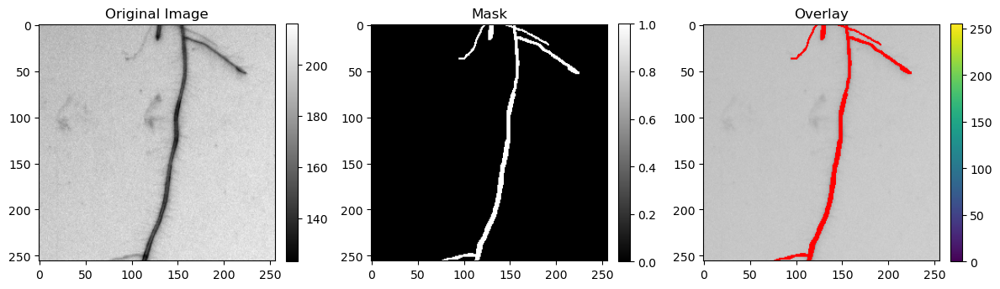

  015_43-18-ROOT1-2023-08-08_pvd_OD001_f6h1_02-Fish Eye Corrected_82.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


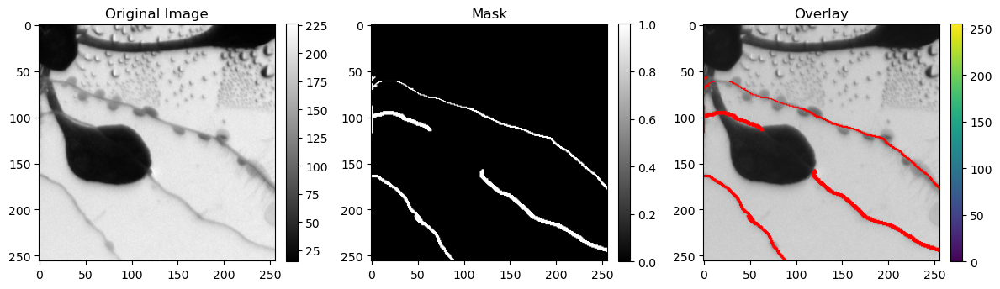

  015_43-18-ROOT1-2023-08-08_pvd_OD001_f6h1_02-Fish Eye Corrected_221.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


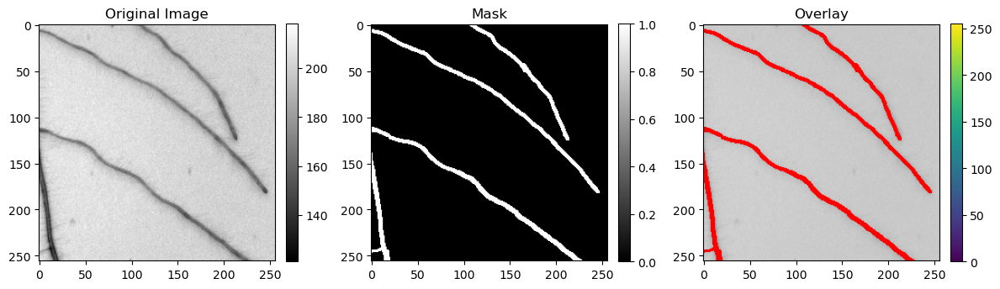

  015_43-18-ROOT1-2023-08-08_pvd_OD001_f6h1_02-Fish Eye Corrected_271.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


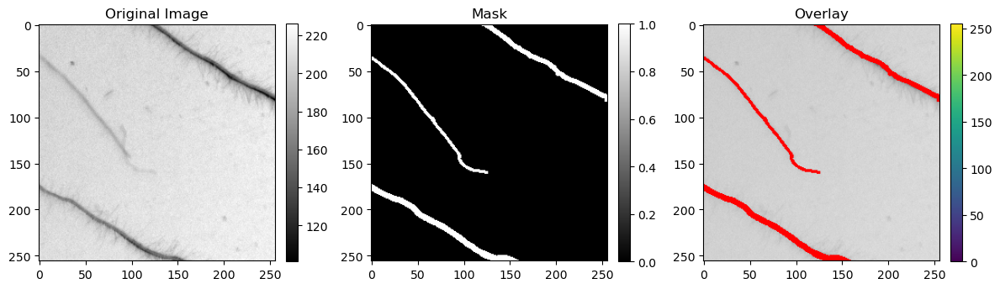

  015_43-18-ROOT1-2023-08-08_pvd_OD001_f6h1_02-Fish Eye Corrected_94.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


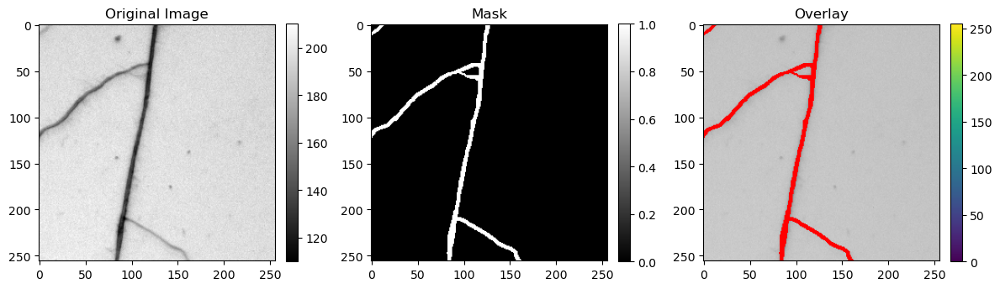


Showing 5 patches from image: 034_43-14-ROOT1-2023-08-08_pvdCherry_OD001_Col0_02-Fish Eye Corrected
  034_43-14-ROOT1-2023-08-08_pvdCherry_OD001_Col0_02-Fish Eye Corrected_269.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


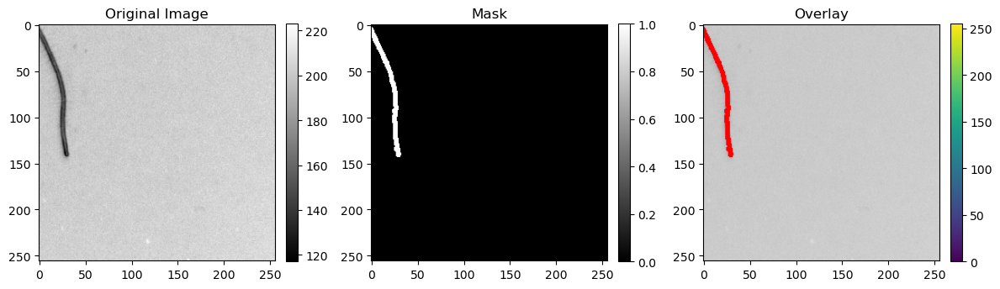

  034_43-14-ROOT1-2023-08-08_pvdCherry_OD001_Col0_02-Fish Eye Corrected_263.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


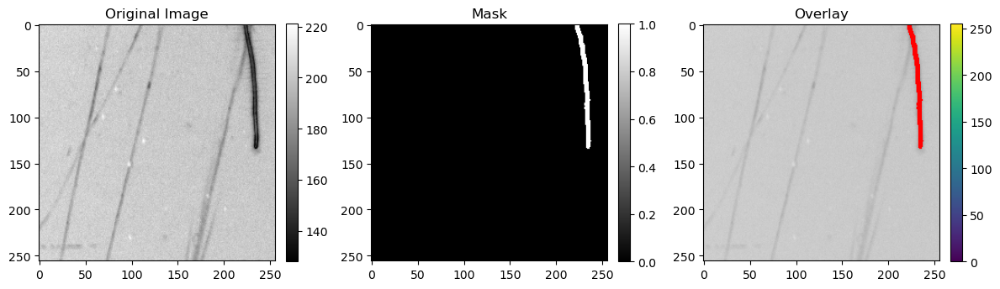

  034_43-14-ROOT1-2023-08-08_pvdCherry_OD001_Col0_02-Fish Eye Corrected_187.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


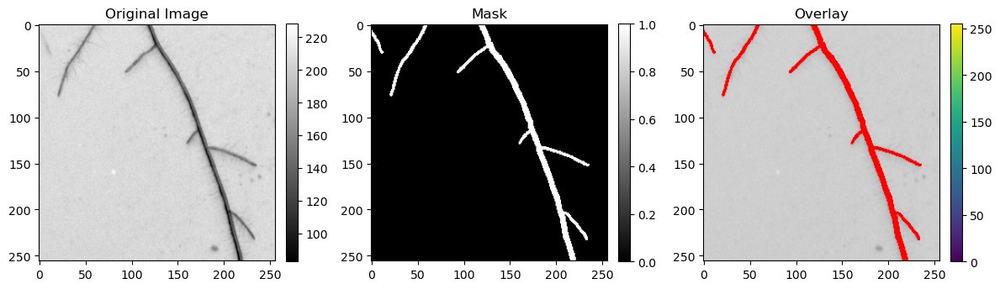

  034_43-14-ROOT1-2023-08-08_pvdCherry_OD001_Col0_02-Fish Eye Corrected_167.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


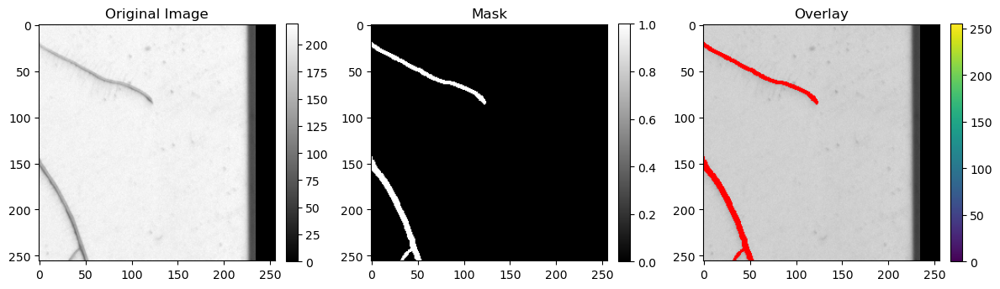

  034_43-14-ROOT1-2023-08-08_pvdCherry_OD001_Col0_02-Fish Eye Corrected_248.png | shape: (256, 256), dtype: uint8, unique mask values: [0 1]


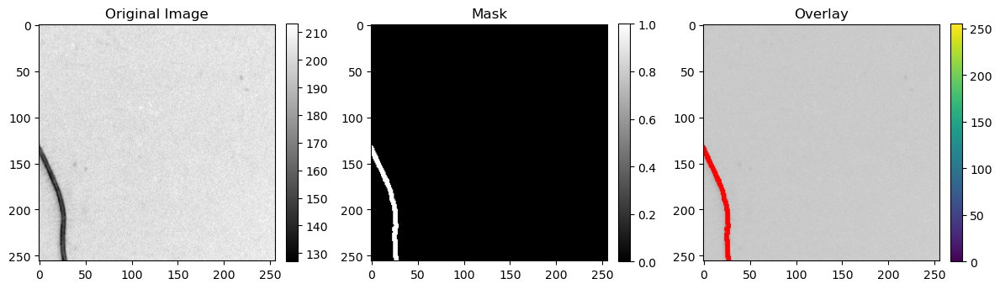

In [ ]:
visualize_random_patches(train_images_out, train_masks_out, num_patches=5)
visualize_random_patches(val_images_out, val_masks_out, num_patches=5)

### Filtering for patches

In the filtering step, we apply a hybrid strategy to ensure that only patches containing meaningful root structures are retained. Specifically, we keep a patch if it contains at least a small percentage of root pixels (above a defined threshold of 0.005, meaning at least 0.5% of the patch must be root) and includes at least one connected root segment larger than a minimum area of at least 75 pixels. I considered multiple strategies to use here, such as a minimum connected root area to detecrt discrete root blobs in the mask, but I figured this might take quite a while in processing, or an edge intersection method to keep only patches where the root touches at least one edge of the path, but this discards roots in the center.

Checking 38808 patch images...
All image patches have corresponding masks.
Looking for mask: 052_43-18-ROOT1-2023-08-08_pvd_OD0001_f6h1_03-Fish Eye Corrected_40.tif


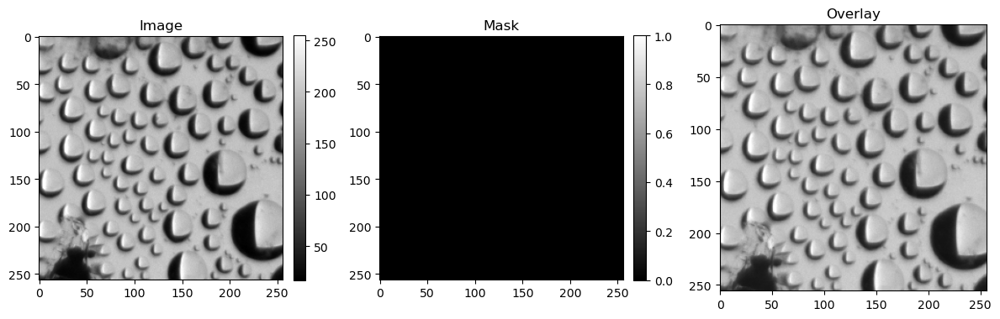

Looking for mask: 049_43-11-ROOT1-2023-08-08_pvd_OD01_f6h1_05-Fish Eye Corrected_361.tif


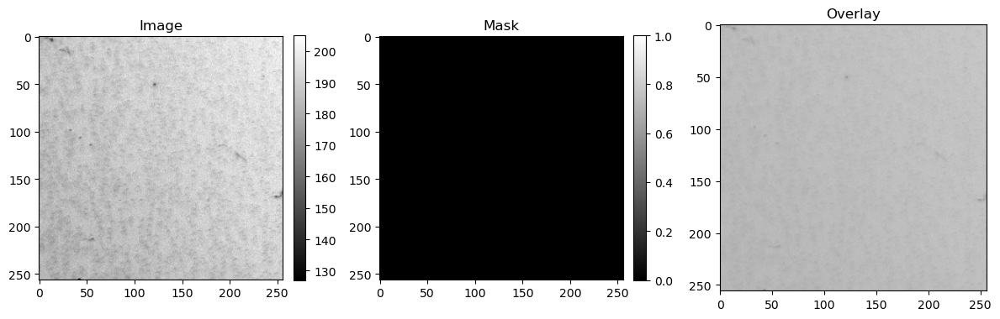

Looking for mask: 048_43-11-ROOT1-2023-08-08_mock_pH5_+Fe_Col0_02-Fish Eye Corrected_274.tif


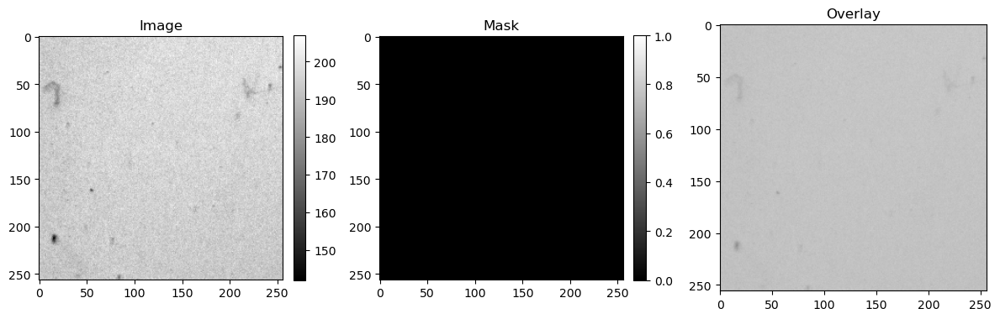

In [3]:
patch_img_dir = Path("patched_dataset_23/train_images/train")
patch_mask_dir = Path("patched_dataset_23/train_masks/train")

img_files = sorted([f for f in patch_img_dir.glob("*.png")])
print(f"Checking {len(img_files)} patch images...")

missing = []
for img_file in img_files:
    base = img_file.stem
    if not (patch_mask_dir / f"{base}.tif").exists():
        missing.append(base)

print("All image patches have corresponding masks." if not missing
      else f"{len(missing)} images with missing masks (showing 5): {missing[:5]}")

def load_png_gray(p: Path):
    im = cv2.imread(str(p), cv2.IMREAD_GRAYSCALE)
    if im is None: raise ValueError(f"Failed to read PNG: {p}")
    return im

def load_mask_tif_gray(p: Path):
    m = cv2.imread(str(p), cv2.IMREAD_GRAYSCALE)
    if m is None:
        raise ValueError(f"Failed to read TIF mask: {p}")
    # Force binary
    m = (m > 0).astype(np.uint8) * 255
    return m

# === Visual Inspection: up to 3 random pairs ===
k = min(3, len(img_files))
if k == 0:
    print("No patches to visualize.")
else:
    for img_path in random.sample(img_files, k):
        base = img_path.stem
        mask_path = patch_mask_dir / f"{base}.tif"
        print("Looking for mask:", mask_path.name)

        try:
            img  = load_png_gray(img_path)
            mask = load_mask_tif_gray(mask_path)
        except Exception as e:
            print("❌", e)
            continue

        overlay = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
        overlay[mask > 0] = [255, 0, 0]

        fig, axs = plt.subplots(1, 3, figsize=(12,4))
        im0 = axs[0].imshow(img, cmap='gray'); axs[0].set_title("Image")
        fig.colorbar(im0, ax=axs[0], fraction=0.046, pad=0.04)

        im1 = axs[1].imshow((mask/255.0), cmap='gray', vmin=0, vmax=1); axs[1].set_title("Mask")
        fig.colorbar(im1, ax=axs[1], fraction=0.046, pad=0.04)

        axs[2].imshow(overlay); axs[2].set_title("Overlay")
        plt.tight_layout(); plt.show(); plt.close(fig)

In [ ]:
# === VISUAL INSPECTION ===
print("=== All Images ===")
for f in sorted(patch_img_dir.glob("*.png"))[:3]:
    print(repr(f.name))

print("=== All Masks ===")
for f in sorted(patch_mask_dir.glob("*.tif"))[:3]:
    print(repr(f.name))

=== All Images ===
'001_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_02-Fish Eye Corrected_0.png'
'001_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_02-Fish Eye Corrected_1.png'
'001_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_02-Fish Eye Corrected_10.png'
=== All Masks ===
'001_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_02-Fish Eye Corrected_0.tif'
'001_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_02-Fish Eye Corrected_1.tif'
'001_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_02-Fish Eye Corrected_10.tif'


### !Disclaimer: The masks may appear as missing because MacOS stores additional image data as '_image_name', as well as 'image_name'.

In [68]:
plt.rcParams['figure.max_open_warning'] = 0   # hush warnings
# === PATCHING & VISUALIZATION ===
def preview_patch_categories(root_patches, bg_patches, num_samples=3):
    def show_patch(title, img_patch, mask_patch):
        img_patch = np.array(img_patch)
        mask_binary = (np.array(mask_patch) > 0).astype(np.uint8)

        overlay = cv2.cvtColor(img_patch, cv2.COLOR_GRAY2BGR) if img_patch.ndim == 2 else img_patch.copy()
        overlay[mask_binary == 1] = [255, 0, 0]

        fig, axs = plt.subplots(1, 3, figsize=(12, 4))
        axs[0].imshow(img_patch, cmap='gray'); axs[0].set_title(f"{title} - Image"); axs[0].axis('off')
        axs[1].imshow(mask_binary, cmap='gray'); axs[1].set_title(f"{title} - Mask");  axs[1].axis('off')
        axs[2].imshow(overlay);               axs[2].set_title(f"{title} - Overlay"); axs[2].axis('off')
        plt.tight_layout(); plt.show(block=False); plt.pause(0.001); plt.close(fig)

    k1 = min(num_samples, len(root_patches))
    for i in range(k1): show_patch("Root-rich", *root_patches[i])

    k2 = min(num_samples, len(bg_patches))
    for i in range(k2): show_patch("Background", *bg_patches[i])

def visualize_random_patches(image_dir, mask_dir, num_patches=5, min_mask_pixels=10):
    files = [f for f in os.listdir(image_dir) if f.endswith('.png') and not f.startswith("._")]
    random.shuffle(files)
    shown = 0
    for fname in files:
        if shown >= num_patches: break
        img_path = os.path.join(image_dir, fname)
        mask_path = os.path.join(mask_dir, fname.replace(".png", ".tif"))

        img  = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if img is None or mask is None or np.sum(mask) < min_mask_pixels: 
            continue

        overlay = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR); overlay[mask > 0] = [255,0,0]

        fig, axs = plt.subplots(1,3, figsize=(12,4))
        axs[0].imshow(img, cmap='gray'); axs[0].set_title("Image"); axs[0].axis('off')
        axs[1].imshow(mask>0, cmap='gray'); axs[1].set_title("Mask"); axs[1].axis('off')
        axs[2].imshow(overlay); axs[2].set_title("Overlay"); axs[2].axis('off')
        plt.tight_layout(); plt.show(block=False); plt.pause(0.001); plt.close(fig)

        shown += 1
    plt.close('all'); gc.collect()

def patch_and_save_filtered_with_preview(image_dir, mask_dir, out_img_dir, out_mask_dir,
                                         patch_size=256, stride=128, visualize=True,
                                         background_ratio=0.5, preview_first_n=1, show_per_class=2):

    for d in [out_img_dir, out_mask_dir]:
        if Path(d).exists(): shutil.rmtree(d)
        Path(d).mkdir(parents=True, exist_ok=True)

    image_files = sorted([f for f in Path(image_dir).glob("*.png") if not f.name.startswith("._")])
    saved = 0

    for idx, img_path in enumerate(image_files):
        stem = img_path.stem
        mlist = list(Path(mask_dir).glob(f"{stem}_root_mask.tif"))
        if not mlist:
            print(f"Mask not found for: {stem}"); continue
        mask_path = mlist[0]

        img  = cv2.imread(str(img_path), cv2.IMREAD_GRAYSCALE)
        mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
        if img is None or mask is None:
            print(f"Failed to load {img_path.name} or mask"); continue

        root_rich, background = create_filtered_patches(img, mask, patch_size, stride)

        # Preview only for the first few source images
        if visualize and idx < preview_first_n:
            preview_patch_categories(root_rich, background, num_samples=show_per_class)

        keep_n = int(len(root_rich) * background_ratio)
        random.shuffle(background); background = background[:keep_n]

        # Save both root-rich and background patches
        all_patches_to_save = root_rich + background
        for img_patch, mask_patch in all_patches_to_save:
            base = f"{stem}_{saved}"
            save_patch(img_patch, Path(out_img_dir) / f"{base}.png")
            
            binary_mask = (mask_patch > 0).astype(np.uint8)
            save_patch(binary_mask, Path(out_mask_dir) / f"{base}.tif")
            saved += 1
        
        plt.close('all'); gc.collect()

    print(f"Saved {saved} total patches.")
    if visualize:
        visualize_random_patches(out_img_dir, out_mask_dir, num_patches=5, min_mask_pixels=10)

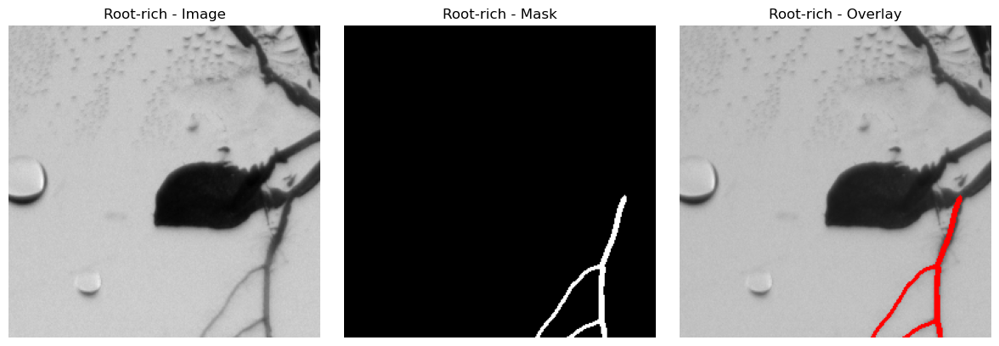

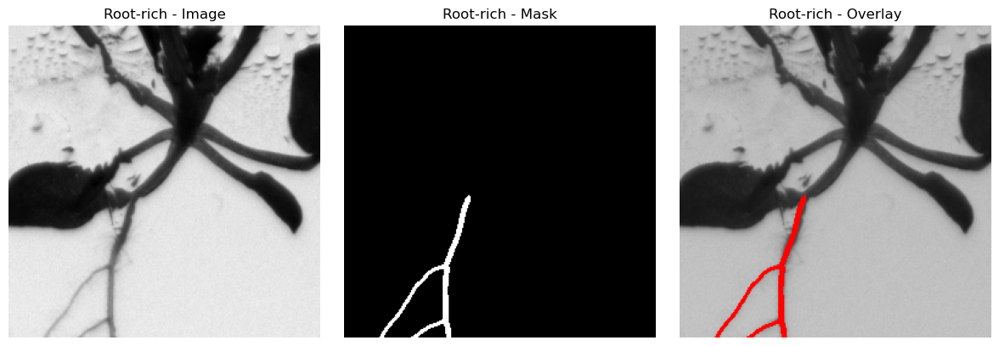

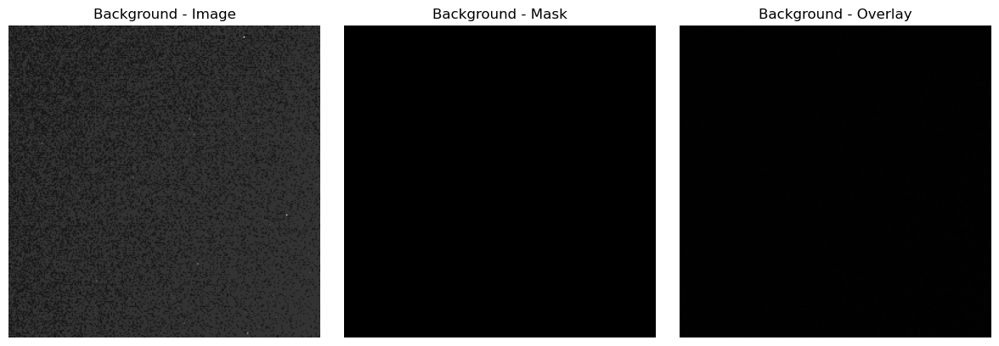

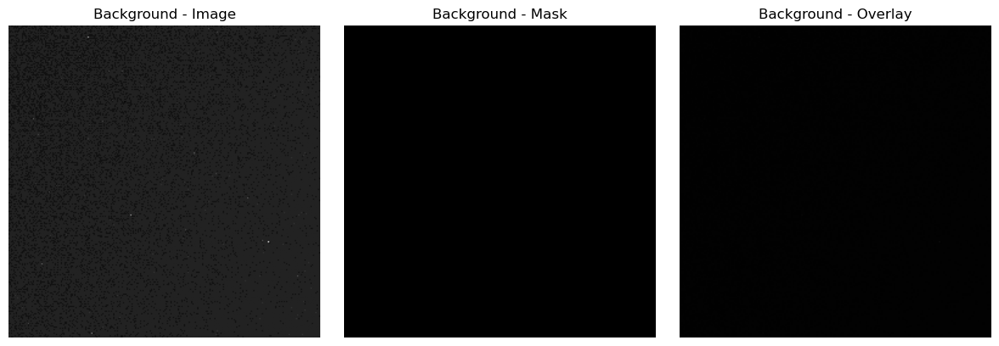

Saved 14184 total patches.


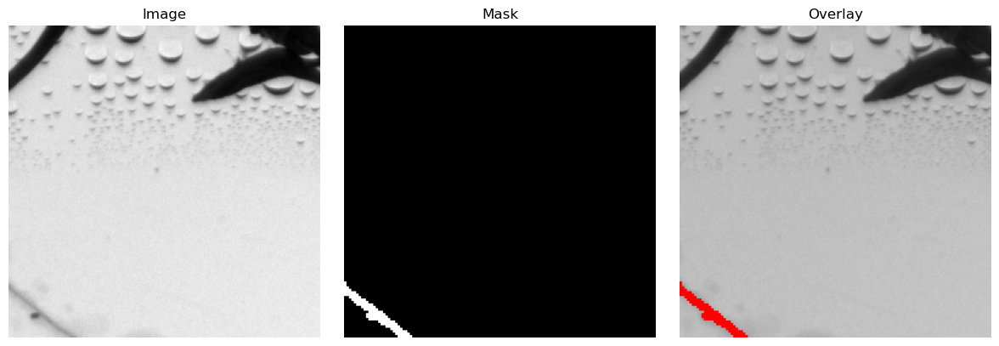

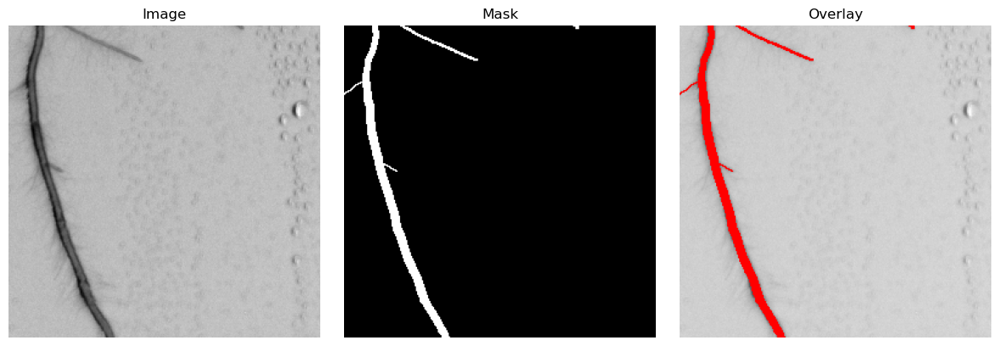

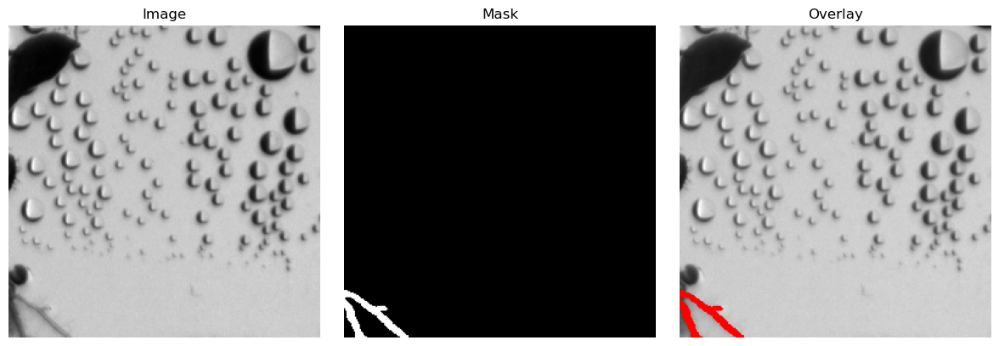

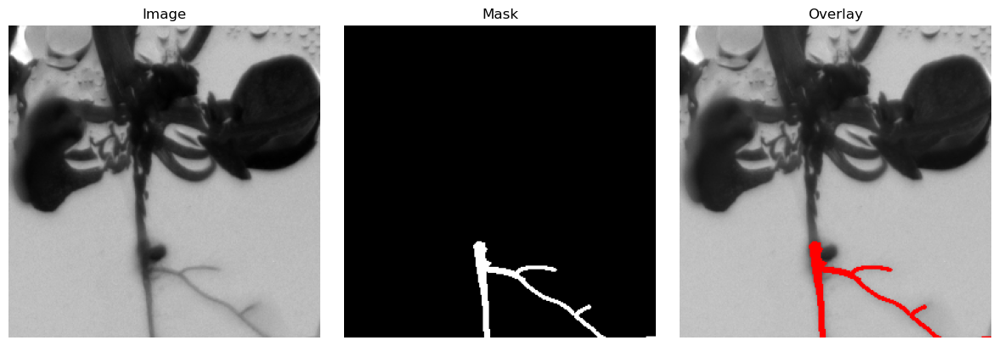

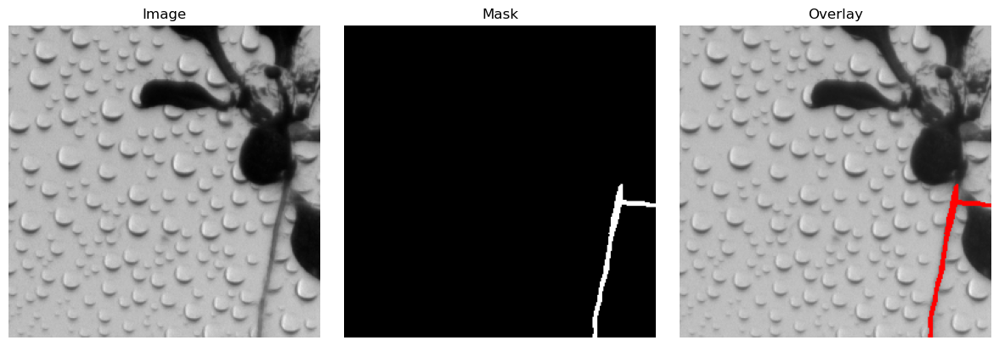

In [6]:
patch_and_save_filtered_with_preview(
    image_dir="dataset_23/train_images/train",
    mask_dir="dataset_23/train_masks/train",
    out_img_dir="simple_filtered_patched_dataset_23/train_images/train",
    out_mask_dir="simple_filtered_patched_dataset_23/train_masks/train",
    patch_size=256,
    stride=128,
    visualize=True
)

In [7]:
# Sanity check
# no unwanted masks
# no orphan images

# Adjust these to match your output structure
paths = {
    "train_images": Path("simple_filtered_patched_dataset_23/train_images/train"),
    "train_masks": Path("simple_filtered_patched_dataset_23/train_masks/train"),
}

# Allowed suffixes
allowed_mask_suffixes = [".tif"]

# Run check for train split
check_folder(paths["train_images"], paths["train_masks"], "train")

NameError: name 'check_folder' is not defined

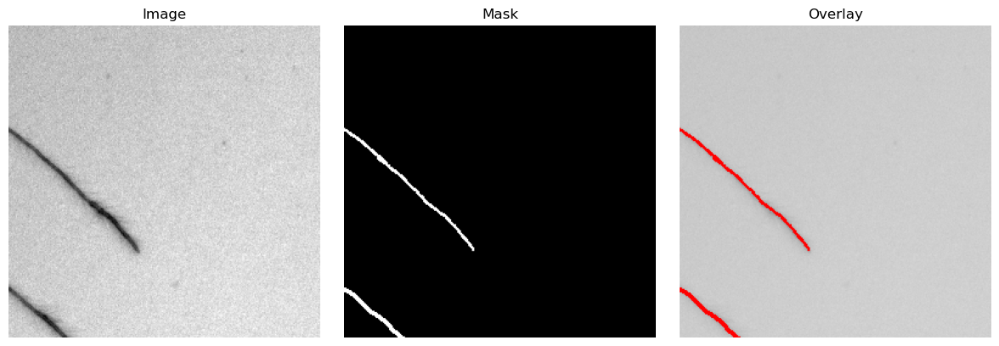

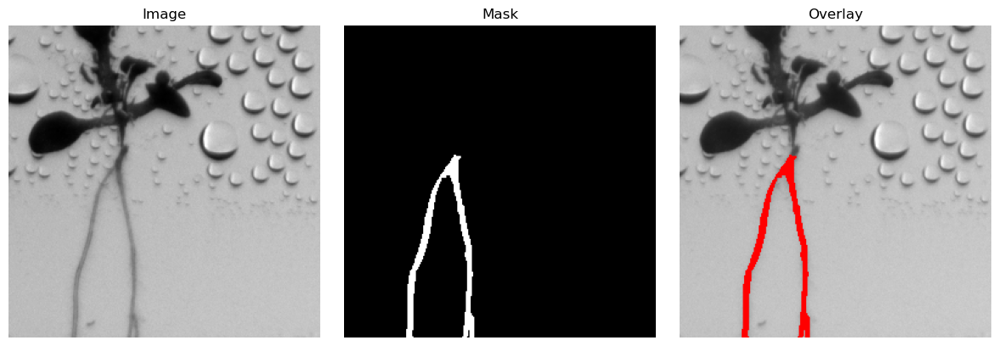

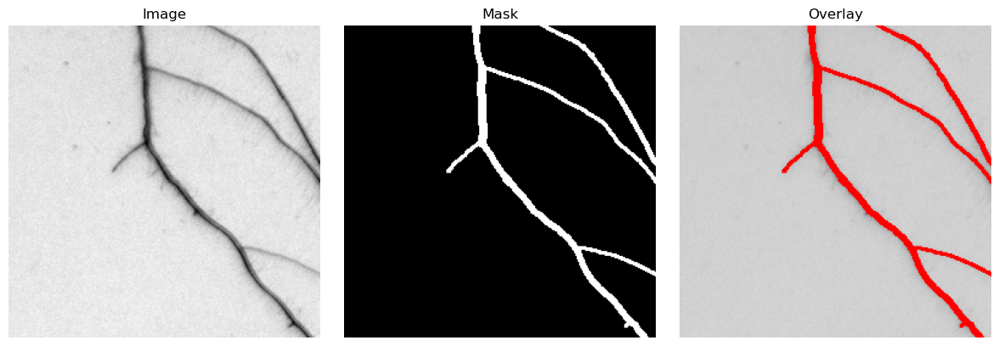

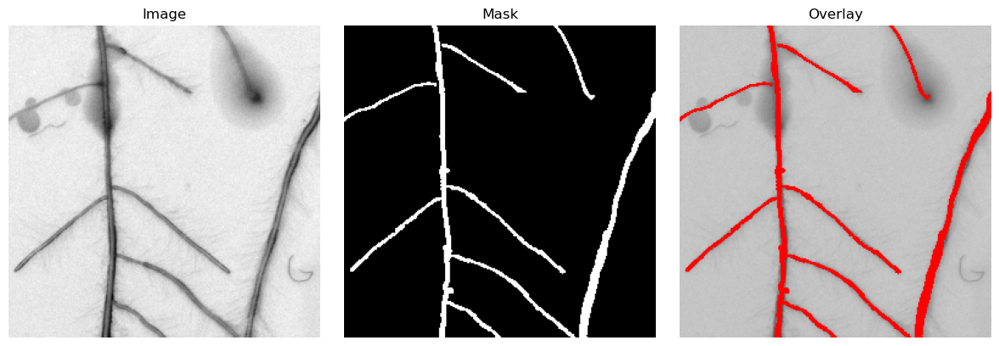

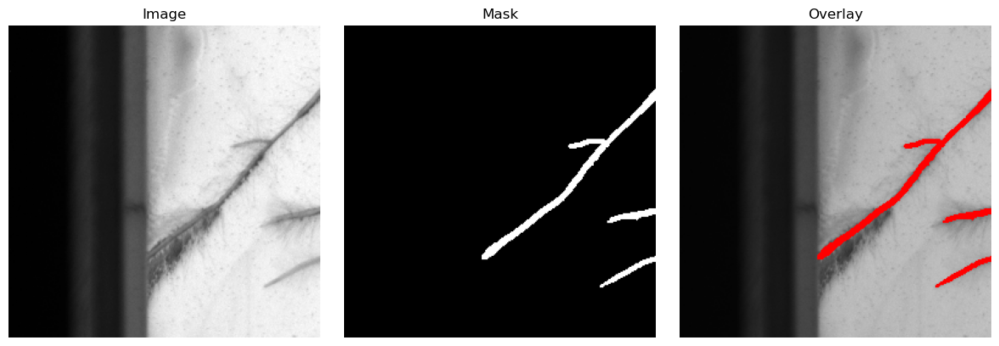

In [ ]:
visualize_random_patches(
    image_dir="simple_filtered_patched_dataset_23/train_images/train",
    mask_dir="simple_filtered_patched_dataset_23/train_masks/train",
    num_patches=5, min_mask_pixels=10
)

## Y2B_24 dataset preprocessing

The 2024 dataset is structured differently. Therefore, it requires a different approach, as the masks are nested inside subfolders, the naming convention of the data is different, there is no occluded_root class, and the images are not split into train/test.

In [ ]:
# === INPUT PATHS ===
images_root = Path(r"C:\BUAS\retake\task_4_full_datasets\Y2B_24\images")
masks_root = Path(r"C:\BUAS\retake\task_4_full_datasets\Y2B_24\masks")

# === BASE OUTPUT FOLDER
base_output = Path("dataset_24")

# === OUTPUT STRUCTURE
output_dirs = {
    "train_images": base_output / "train_images/train",
    "train_masks": base_output / "train_masks/train",
    "val_images": base_output / "val_images/val",
    "val_masks": base_output / "val_masks/val",
}

# Create output directories
for out_dir in output_dirs.values():
    out_dir.mkdir(parents=True, exist_ok=True)

# === Step 1: Collect all root mask base names from subfolders
valid_mask_suffix = "_root_mask.tif"
all_mask_files = list(masks_root.rglob(f"*{valid_mask_suffix}"))
mask_basenames = {f.name.replace("_root_mask.tif", "") for f in all_mask_files}

print(f"Found {len(all_mask_files)} root masks from all annotators.")

# === Step 2: Collect matching images
image_files = [
    f for f in images_root.glob("*.png")
    if f.stem in mask_basenames and not f.name.startswith("._")
]
print(f"Found {len(image_files)} images with matching root masks.")

# === Step 3: Split into train/val (80/20)
random.seed(42)
random.shuffle(image_files)
split_index = int(0.2 * len(image_files))
val_images = image_files[:split_index]
train_images = image_files[split_index:]
print(f"Validation image: {val_images[0].name if val_images else 'None'}")

def copy_image_and_mask(image_file, mask_dest_dir, image_dest_dir):
    base = image_file.stem  # e.g. train_Alican_etc

    # Look through all mask paths recursively for a match
    match = [
        m for m in all_mask_files
        if m.name.startswith(base) and m.name.endswith("_root_mask.tif")
    ]

    if not match:
        print(f"No matching root mask found for {image_file.name}")
        return

    mask_file = match[0]
    print(f"Copying: {image_file.name} and {mask_file.name}")

    shutil.copy(image_file, image_dest_dir / image_file.name)
    shutil.copy(mask_file, mask_dest_dir / mask_file.name)

# === Step 4: Copy to destination folders
for f in train_images:
    copy_image_and_mask(f, output_dirs["train_masks"], output_dirs["train_images"])

for f in val_images:
    copy_image_and_mask(f, output_dirs["val_masks"], output_dirs["val_images"])

print(f"Copied {len(train_images)} train images and {len(val_images)} val images.")

# === Step 5: Warn about discarded masks
all_masks = list(masks_root.rglob("*.tif"))
discarded = [f for f in all_masks if not f.name.endswith(valid_mask_suffix)]
if discarded:
    print(f"Discarded {len(discarded)} unwanted masks (non-root types):")
    for f in discarded[:5]:
        print("  -", f.name)

print("Y2B_24 dataset cleaned and restructured successfully.")

Found 628 root masks from all annotators.
Found 314 images with matching root masks.
Validation image: train_Shival_232374_im5.png
Copying: val_Myrthe_221989_im5.png and val_Myrthe_221989_im5_root_mask.tif
Copying: train_Dean_233582_im5.png and train_Dean_233582_im5_root_mask.tif
Copying: train_Alican_230858_im2.png and train_Alican_230858_im2_root_mask.tif
Copying: train_Dean_221846_im5.png and train_Dean_221846_im5_root_mask.tif
Copying: train_Elavendan_233594_im2.png and train_Elavendan_233594_im2_root_mask.tif
Copying: train_Elavendan_232345_im1.png and train_Elavendan_232345_im1_root_mask.tif
Copying: train_Elavendan_236730_im5.png and train_Elavendan_236730_im5_root_mask.tif
Copying: train_Dean_221846_im1.png and train_Dean_221846_im1_root_mask.tif
Copying: val_Myrthe_233650_im5.png and val_Myrthe_233650_im5_root_mask.tif
Copying: train_Shival_233182_im2.png and train_Shival_233182_im2_root_mask.tif
Copying: train_Alican_232922_im5.png and train_Alican_232922_im5_root_mask.tif
Co

In [ ]:
# Sanity check
paths = {
    "train_images": Path("dataset_24/train_images/train"),
    "train_masks": Path("dataset_24/train_masks/train"),
    "test_images": Path("dataset_24/val_images/val"),
    "test_masks": Path("dataset_24/val_masks/val"),
}

# Allowed suffixes
allowed_mask_suffixes = ["_root_mask.tif"]

def get_base(filename, suffixes):
    for s in suffixes:
        if filename.endswith(s):
            return filename.replace(s, "")
    return None

def check_folder(images_path, masks_path, split_name):
    print(f"\nChecking {split_name.upper()} set...")

    # 1. Check for unwanted masks
    mask_files = list(masks_path.glob("*.tif"))
    unwanted = [f.name for f in mask_files if not any(f.name.endswith(s) for s in allowed_mask_suffixes)]
    if unwanted:
        print(f"Found {len(unwanted)} unwanted mask files:")
        for name in unwanted:
            print("  -", name)
    else:
        print("No unwanted mask types found.")

    # 2. Check image-mask matches
    image_files = list(images_path.glob("*.png"))
    base_image_names = {f.stem for f in image_files}
    base_mask_names = {get_base(f.name, allowed_mask_suffixes) for f in mask_files if get_base(f.name, allowed_mask_suffixes)}

    unmatched_images = base_image_names - base_mask_names
    if unmatched_images:
        print(f"{len(unmatched_images)} images with NO root masks:")
        for name in unmatched_images:
            print("  -", name + ".png")
    else:
        print("All images have at least one corresponding root mask.")

    # Summary
    print(f"{len(image_files)} images, {len(mask_files)} masks.")

# Run check for both splits
check_folder(paths["train_images"], paths["train_masks"], "train")
check_folder(paths["test_images"], paths["test_masks"], "test")


Checking TRAIN set...
No unwanted mask types found.
All images have at least one corresponding root mask.
252 images, 252 masks.

Checking TEST set...
No unwanted mask types found.
All images have at least one corresponding root mask.
62 images, 62 masks.


### Padding, pathcifying, saving the patches

In [ ]:
# Input directories
images_y24_train = "dataset_24/train_images/train"
masks_y24_train = "dataset_24/train_masks/train"
images_y24_val = "dataset_24/val_images/val"
masks_y24_val = "dataset_24/val_masks/val"

# Output directories
train_images_out = "patched_dataset_24/train_images/train"
train_masks_out = "patched_dataset_24/train_masks/train"
val_images_out = "patched_dataset_24/val_images/val"
val_masks_out = "patched_dataset_24/val_masks/val"

# Patchify Y2B_24 train
patchify_and_save(images_y24_train, masks_y24_train, train_images_out, train_masks_out, patch_size=256, step=128)

# Patchify Y2B_24 val
patchify_and_save(images_y24_val, masks_y24_val, val_images_out, val_masks_out, patch_size=256, step=128)


Done patchifying images from: dataset_24/train_images/train
Patch Statistics:
  - Background patches       : 90630
  - Root patches             : 20502
  - Small root patches (<30) : 589

Patchifying Summary:
  - Total images processed   : 252
  - Total patches saved      : 111132
  - Average patches per image: 441.00

Done patchifying images from: dataset_24/val_images/val
Patch Statistics:
  - Background patches       : 22579
  - Root patches             : 4763
  - Small root patches (<30) : 141

Patchifying Summary:
  - Total images processed   : 62
  - Total patches saved      : 27342
  - Average patches per image: 441.00


### Testing

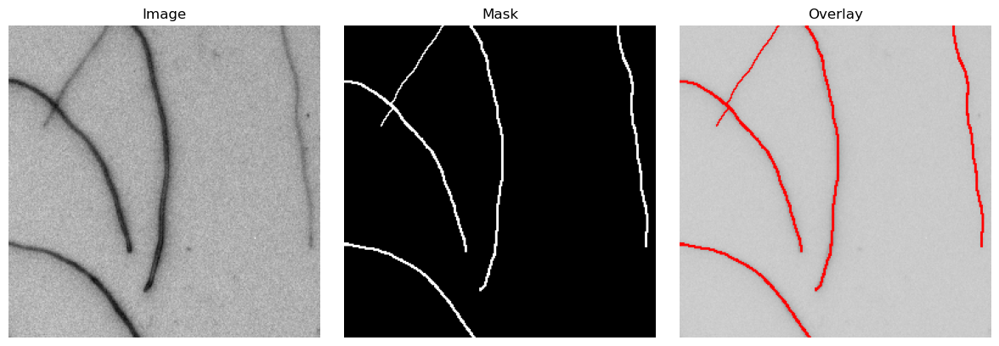

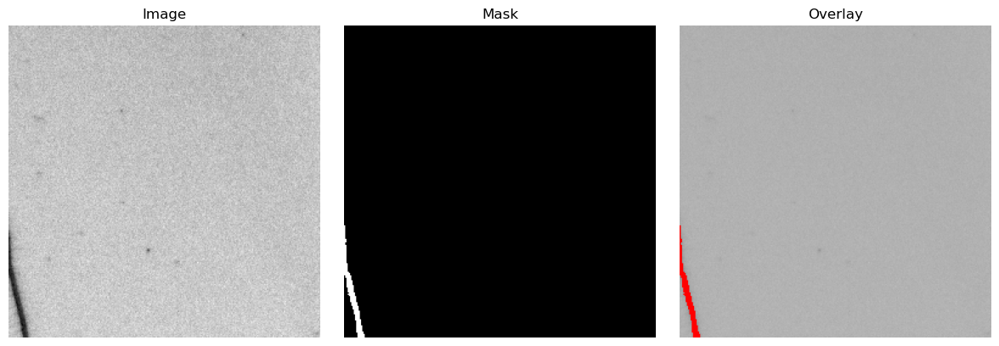

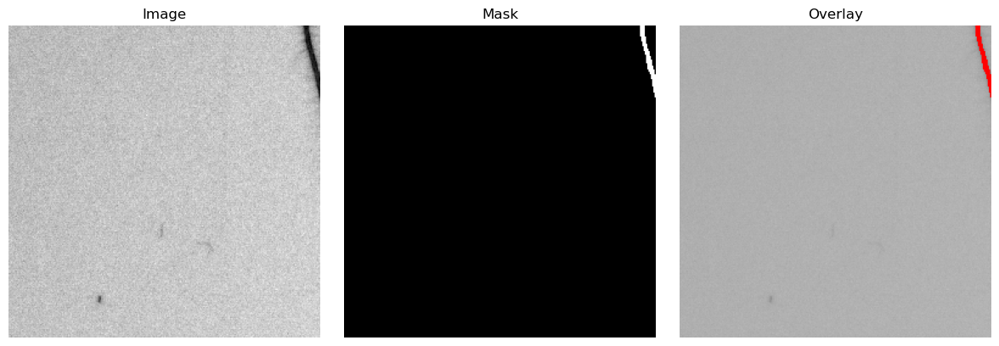

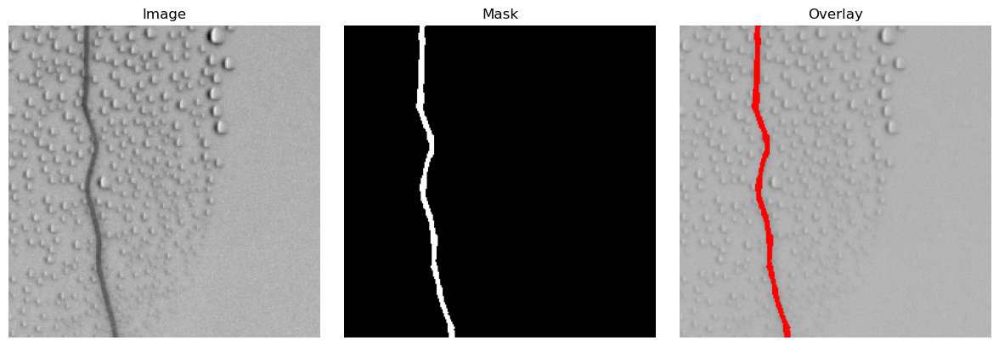

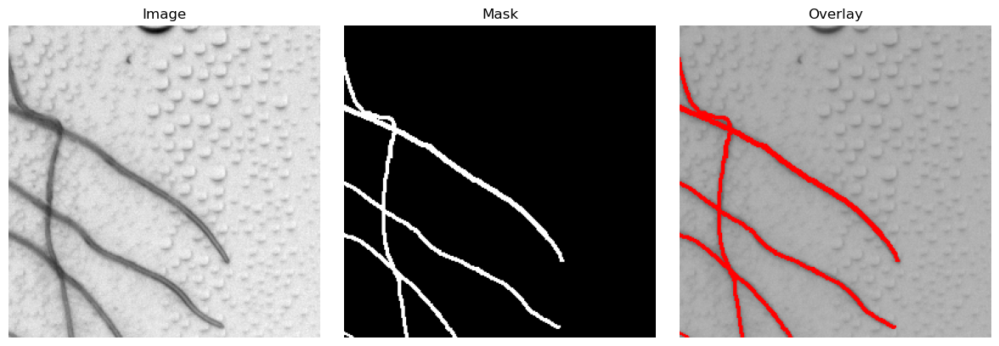

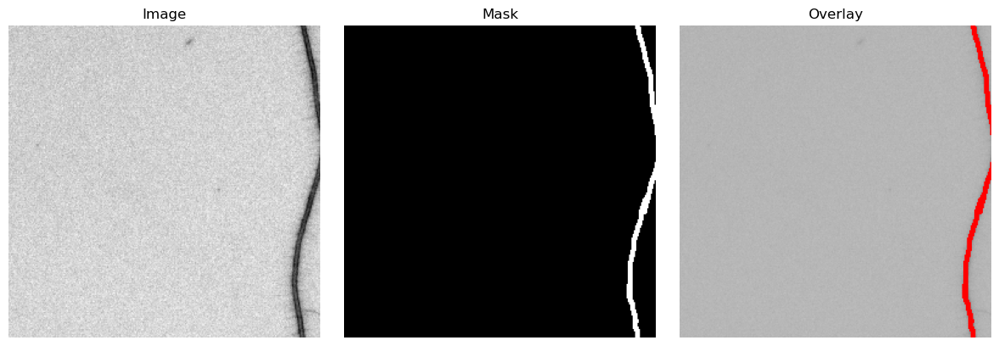

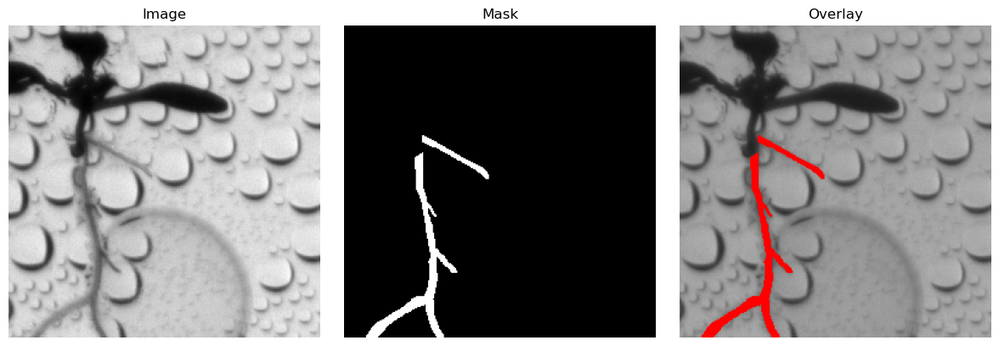

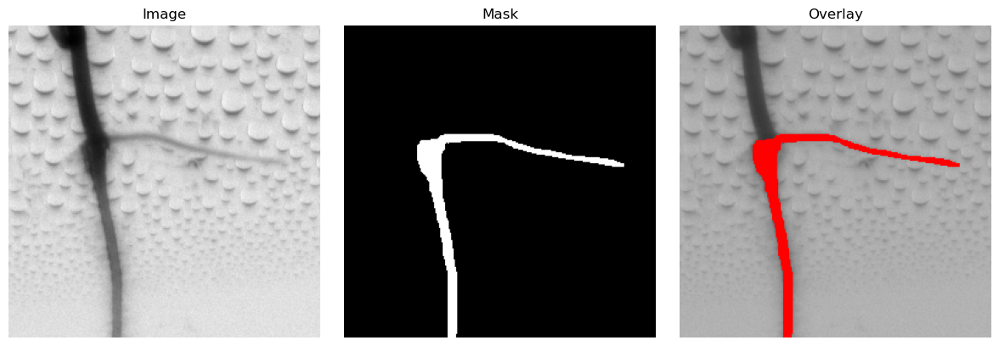

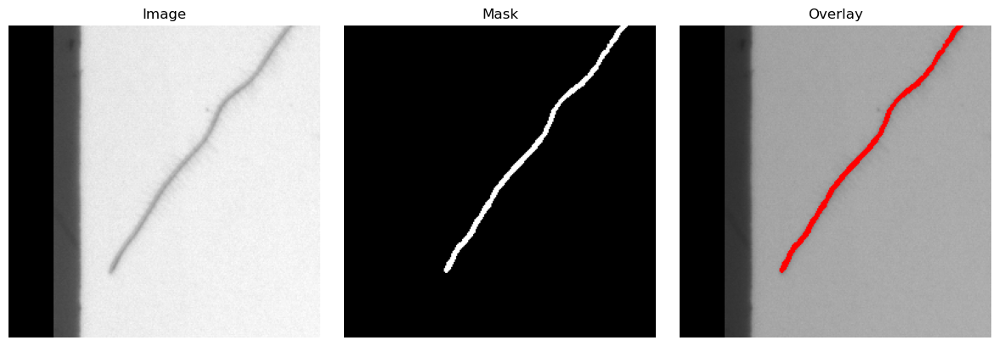

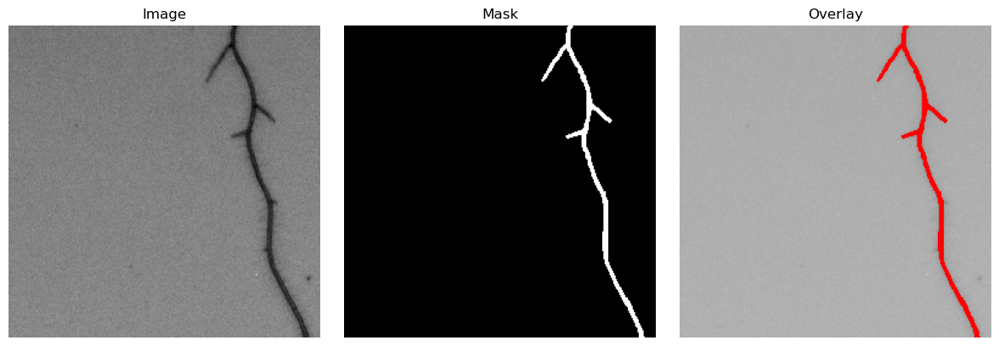

In [ ]:
visualize_random_patches(train_images_out, train_masks_out, num_patches=5)
visualize_random_patches(val_images_out, val_masks_out, num_patches=5)

### Filtering patches

Checking 111132 patch images...
All image patches have corresponding masks.
Looking for mask: train_Shival_232374_im2_133.tif


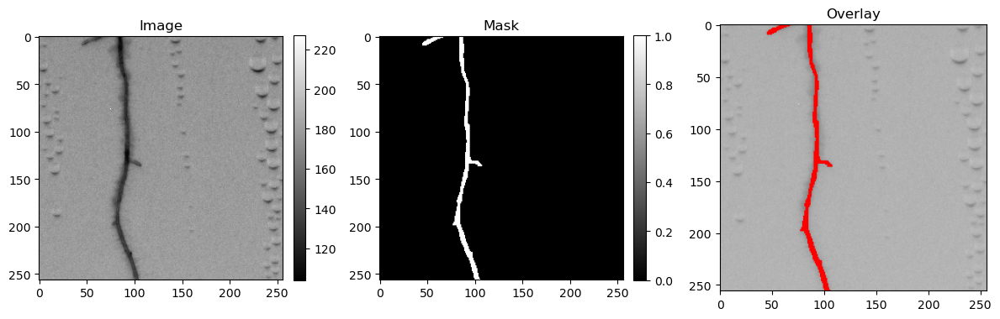

Looking for mask: train_Karna_232567_im4_392.tif


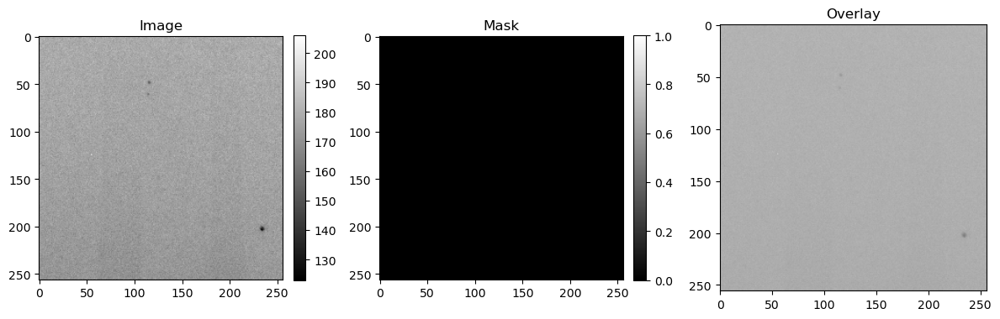

Looking for mask: train_Elavendan_235159_im4_268.tif


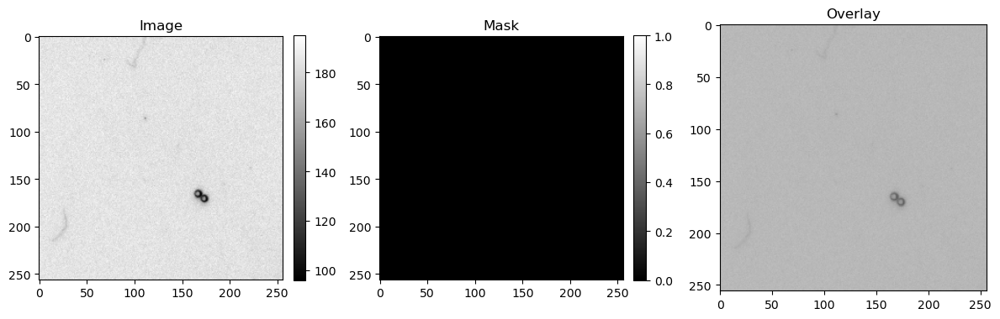

In [ ]:
# Paths
patch_img_dir = Path("patched_dataset_24/train_images/train")
patch_mask_dir = Path("patched_dataset_24/train_masks/train")

img_files = sorted([f for f in patch_img_dir.glob("*.png")])
print(f"Checking {len(img_files)} patch images...")

missing = []
for img_file in img_files:
    base = img_file.stem
    if not (patch_mask_dir / f"{base}.tif").exists():
        missing.append(base)

print("All image patches have corresponding masks." if not missing
      else f"{len(missing)} images with missing masks (showing 5): {missing[:5]}")

def load_png_gray(p: Path):
    im = cv2.imread(str(p), cv2.IMREAD_GRAYSCALE)
    if im is None: raise ValueError(f"Failed to read PNG: {p}")
    return im

def load_mask_tif_gray(p: Path):
    m = cv2.imread(str(p), cv2.IMREAD_GRAYSCALE)
    if m is None:
        raise ValueError(f"Failed to read TIF mask: {p}")
    # Force binary
    m = (m > 0).astype(np.uint8) * 255
    return m

# === Visual Inspection: up to 3 random pairs ===
k = min(3, len(img_files))
if k == 0:
    print("No patches to visualize.")
else:
    for img_path in random.sample(img_files, k):
        base = img_path.stem
        mask_path = patch_mask_dir / f"{base}.tif"
        print("Looking for mask:", mask_path.name)

        try:
            img  = load_png_gray(img_path)
            mask = load_mask_tif_gray(mask_path)
        except Exception as e:
            print("❌", e)
            continue

        overlay = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
        overlay[mask > 0] = [255, 0, 0]

        fig, axs = plt.subplots(1, 3, figsize=(12,4))
        im0 = axs[0].imshow(img, cmap='gray'); axs[0].set_title("Image")
        fig.colorbar(im0, ax=axs[0], fraction=0.046, pad=0.04)

        im1 = axs[1].imshow((mask/255.0), cmap='gray', vmin=0, vmax=1); axs[1].set_title("Mask")
        fig.colorbar(im1, ax=axs[1], fraction=0.046, pad=0.04)

        axs[2].imshow(overlay); axs[2].set_title("Overlay")
        plt.tight_layout(); plt.show(); plt.close(fig)

In [ ]:
# === VISUAL INSPECTION ===
print("=== All Images ===")
for f in sorted(patch_img_dir.glob("*.png"))[:3]:
    print(repr(f.name))

print("=== All Masks ===")
for f in sorted(patch_mask_dir.glob("*.tif"))[:3]:
    print(repr(f.name))

=== All Images ===
'train_Alican_212231_im1_0.png'
'train_Alican_212231_im1_1.png'
'train_Alican_212231_im1_10.png'
=== All Masks ===
'train_Alican_212231_im1_0.tif'
'train_Alican_212231_im1_1.tif'
'train_Alican_212231_im1_10.tif'


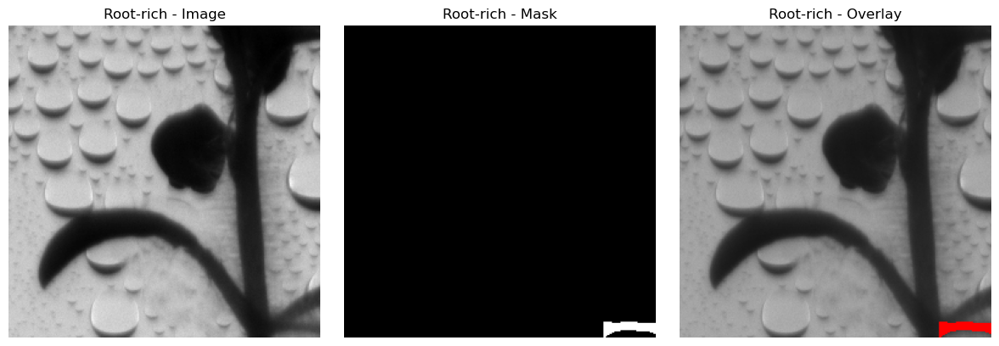

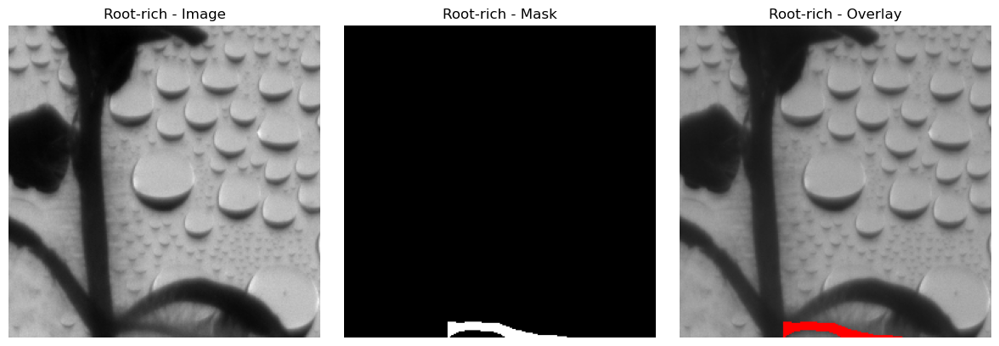

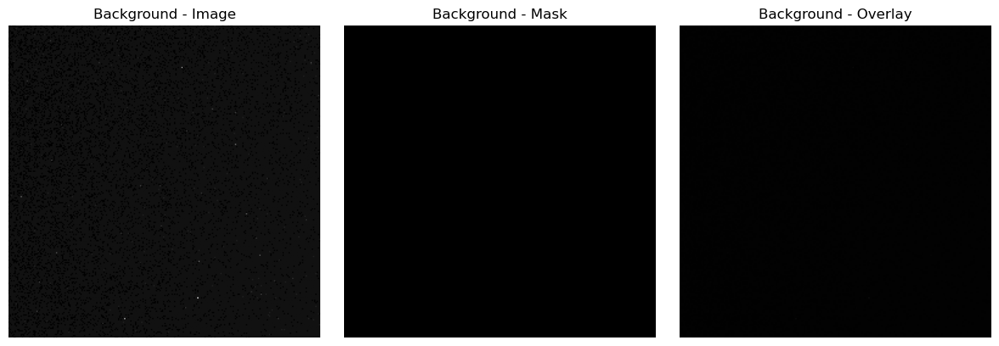

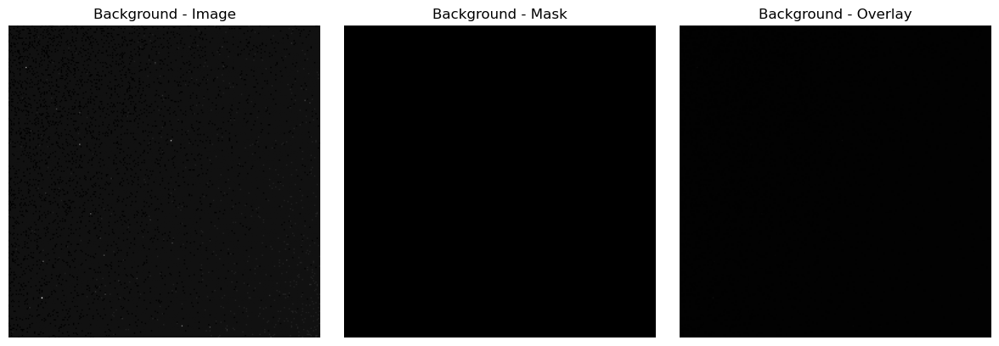

Saved 24466 total patches.


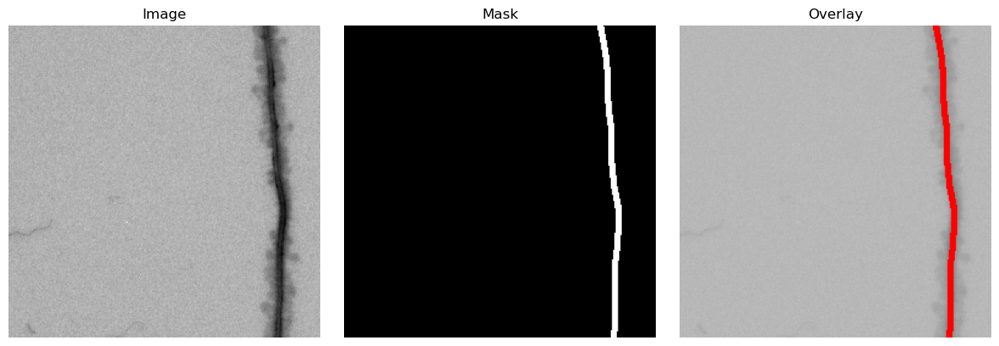

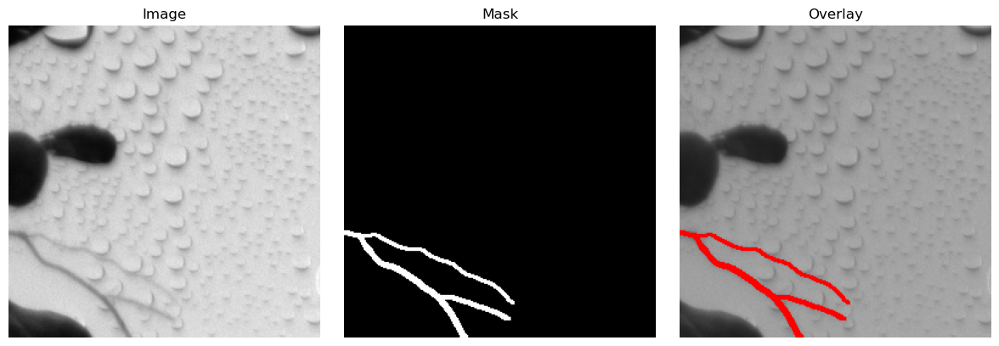

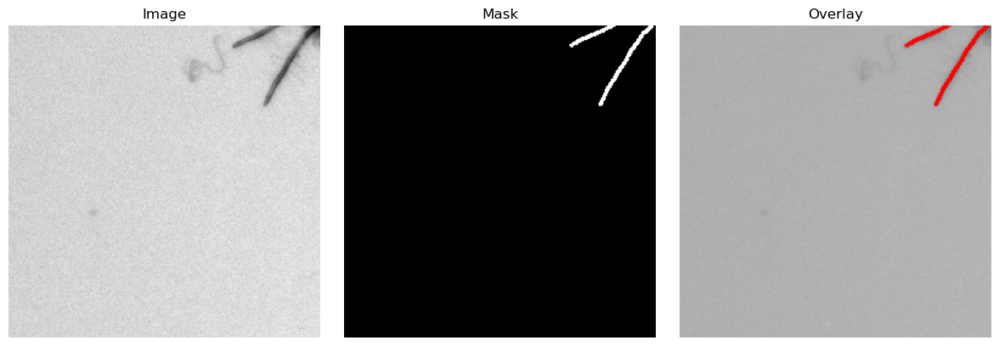

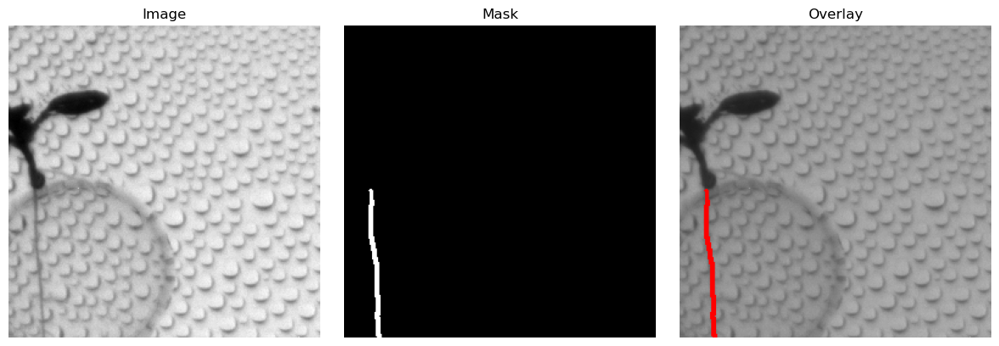

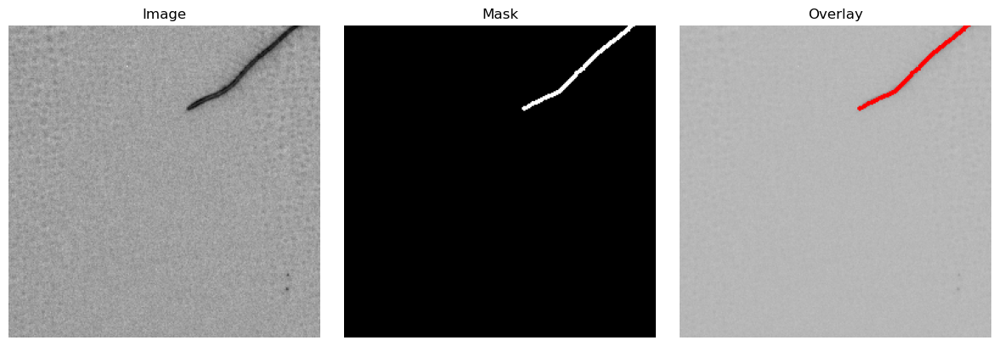

In [ ]:
patch_and_save_filtered_with_preview(
    image_dir="dataset_24/train_images/train",
    mask_dir="dataset_24/train_masks/train",
    out_img_dir="simple_filtered_patched_dataset_24/train_images/train",
    out_mask_dir="simple_filtered_patched_dataset_24/train_masks/train",
    patch_size=256,
    stride=128,
    visualize=True
)

In [ ]:
# Sanity check
# no unwanted masks
# no orphan images

# Adjust these to match your output structure
paths = {
    "train_images": Path("simple_filtered_patched_dataset_24/train_images/train"),
    "train_masks": Path("simple_filtered_patched_dataset_24/train_masks/train"),
}

# Allowed suffixes
allowed_mask_suffixes = [".tif"]

# Run check for train split
check_folder(paths["train_images"], paths["train_masks"], "train")


Checking TRAIN set...
No unwanted mask types found.
All images have at least one corresponding root mask.
24466 images, 24466 masks.


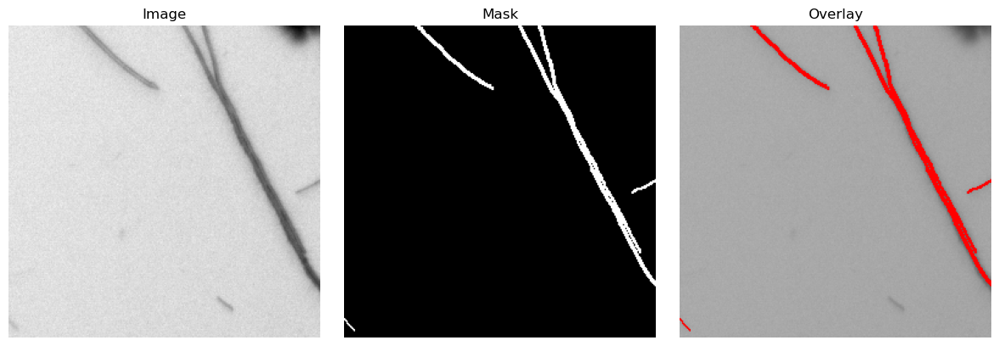

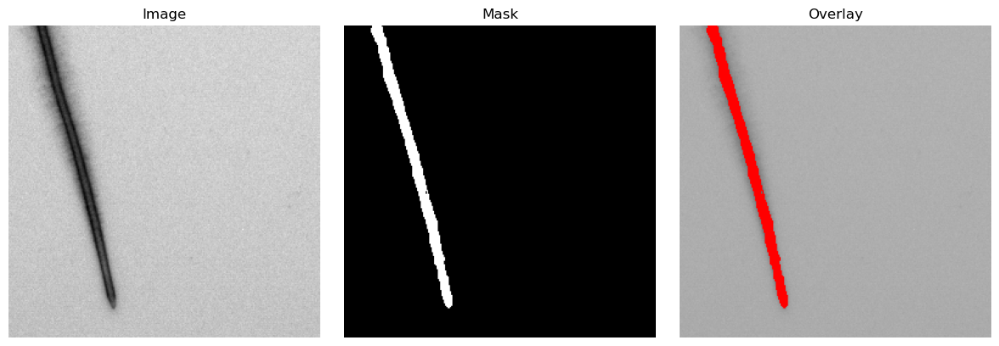

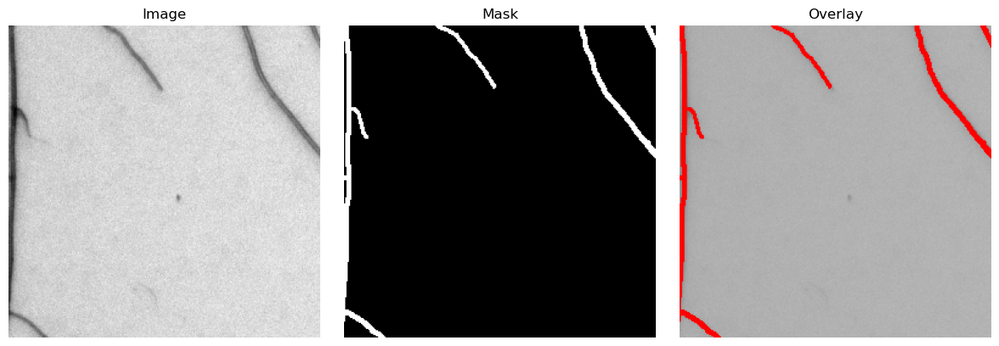

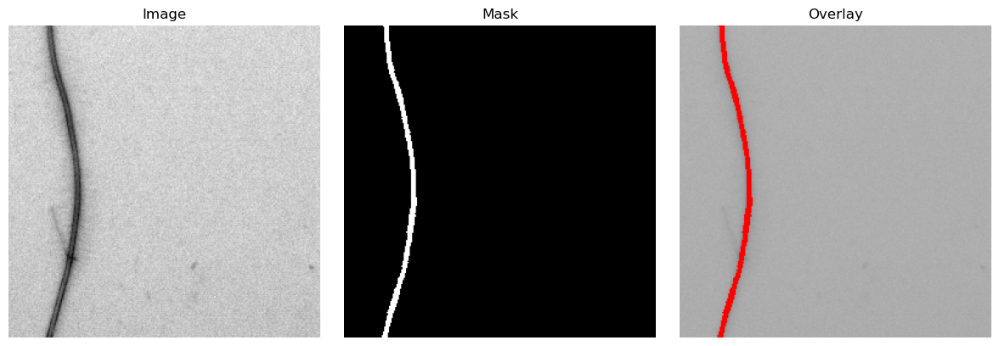

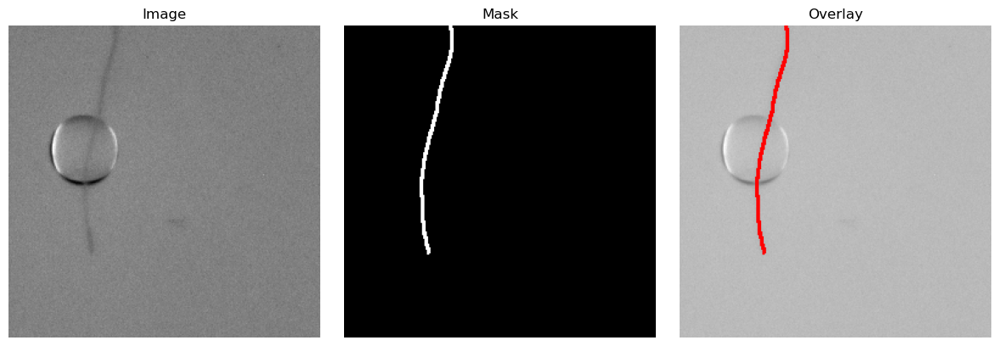

In [ ]:
visualize_random_patches(
    image_dir="simple_filtered_patched_dataset_24/train_images/train",
    mask_dir="simple_filtered_patched_dataset_24/train_masks/train",
    num_patches=5, min_mask_pixels=10
)

## Combining datasets: dataset & simple_filtered_dataset

Now, I will combine both datasets for the final versions. Only the validation data from Y2B_24 will be kept, as per the requirements in task 5. I wanted to keep a version that is pre-filtering and one that is post_filtering.

In [9]:
def merge_datasets(
    src1, src2, dest,
    include_val_from=None
):
    # Define dirs
    for split in ["train_images/train", "train_masks/train"]:
        (Path(dest) / split).mkdir(parents=True, exist_ok=True)

    def copy_all(source_dir, dest_dir, ext=".png"):
        files = list(Path(source_dir).glob(f"*{ext}"))
        for f in files:
            shutil.copy(f, dest_dir)


    # Copy training data from both datasets
    copy_all(Path(src1) / "train_images/train", Path(dest) / "train_images/train", ext=".png")
    copy_all(Path(src2) / "train_images/train", Path(dest) / "train_images/train", ext=".png")
    copy_all(Path(src1) / "train_masks/train", Path(dest) / "train_masks/train", ext=".tif")
    copy_all(Path(src2) / "train_masks/train", Path(dest) / "train_masks/train", ext=".tif")


    print(f"Merged training data from {src1} and {src2} into {dest}")

    # To include only the 2023 val set
    if include_val_from:
        for split in ["val_images/val", "val_masks/val"]:
            src_val = Path(include_val_from) / split
            dst_val = Path(dest) / split
            shutil.copytree(src_val, dst_val, dirs_exist_ok=True)
        print(f"Included validation set from {include_val_from}")

In [188]:
merge_datasets(
    src1="simple_filtered_patched_dataset_23",
    src2="simple_filtered_patched_dataset_24",
    dest="simple_filtered_dataset",
    include_val_from="patched_dataset_24"
)

Merged training data from simple_filtered_patched_dataset_23 and simple_filtered_patched_dataset_24 into simple_filtered_dataset
Included validation set from patched_dataset_24


In [189]:
merge_datasets(
    src1="patched_dataset_23",
    src2="patched_dataset_24",
    dest="dataset",
    include_val_from="patched_dataset_24"
)

Merged training data from patched_dataset_23 and patched_dataset_24 into dataset
Included validation set from patched_dataset_24


## Parameter search

Because I was unsure if the parameters I gave as input to my filtering algorithm would perform best, I decided to compile a tuner to find the best min_ratio (minimum proportion of root pixels per patch) and min_area (minimum size of a connected root blob, expressed in pixels), using `optuna`. The algorithm searches for the best parameters per dataset to be as accurate as possible.

The purpose of this logic is to produce the most useful and meaningful patches, with high root content (so no empty background), fewer edge-only patches, and balanced sensitivity across patch types (accepts small, sparse, but meaningful patches like lateral roots and tips, but not so loose that it lets in random background or noise). For each combination of parameters, it loops through the mask patches, calculated the ratio of root pixels (`root density`), checks if the connected blobs are larger that `min_area`, checks if the patch touches the border of the original image, and decides to keep or skip the patch based on the `min_ratio`.

I then inputed the found parameters into the algorithms of each dataset and saved the filtered patches in new datasets.

I also decided to visualise 2 sets (after 2 iterations of patchifying) of patches that were rejected to make sure the algorithm was doing its job.

### Y2B_23 dataset

In [55]:
def load_mask(path):
    return np.array(Image.open(path))


def compute_root_density(mask_patch):
    return np.count_nonzero(mask_patch) / mask_patch.size


def has_large_blob(mask_patch, min_area):
    labeled, num = label(mask_patch > 0)
    sizes = [(labeled == i).sum() for i in range(1, num + 1)]
    return any(area >= min_area for area in sizes)


def hybrid_filter(mask_patch, min_ratio, min_area):
    density = compute_root_density(mask_patch)
    return density >= min_ratio and has_large_blob(mask_patch, min_area)


def evaluate_filter_config(patch_mask_dir, min_ratio, min_area):
    mask_files = [f for f in Path(patch_mask_dir).glob("*.png") if not f.name.startswith("._")]
    densities = []
    skipped_border = 0
    kept = 0

    for f in mask_files:
        mask = load_mask(f)
        h, w = mask.shape

        name_parts = f.stem.split("_")
        try:
            y, x = int(name_parts[-2]), int(name_parts[-1])
        except ValueError:
            continue

        is_border = (x + 256 >= w) or (y + 256 >= h)
        keep = hybrid_filter(mask, min_ratio, min_area)

        if keep:
            densities.append(compute_root_density(mask))
            kept += 1
        elif is_border:
            skipped_border += 1

    if kept == 0:
        return 0.0  # penalize configs that discard everything

    mean_density = np.mean(densities)
    penalty = skipped_border / len(mask_files) if mask_files else 0
    return mean_density - penalty


def objective(trial):
    min_ratio = trial.suggest_float("min_ratio", 0.001, 0.02, log=True) # log scaled
    min_area = trial.suggest_int("min_area", 20, 150) # integer

    return evaluate_filter_config(
        patch_mask_dir="patched_dataset_23/train_masks/train",
        min_ratio=min_ratio,
        min_area=min_area,
    )


# Run study
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)

# Results
best_params = study.best_params
print("Best parameters:", best_params)
print("Best score:", study.best_value)

study.trials_dataframe()


[I 2025-08-14 07:59:27,127] A new study created in memory with name: no-name-d8eac51a-124a-4309-8abb-cfd108c46a49
[I 2025-08-14 07:59:28,151] Trial 0 finished with value: 0.0 and parameters: {'min_ratio': 0.0012796844053026945, 'min_area': 78}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:59:28,217] Trial 1 finished with value: 0.0 and parameters: {'min_ratio': 0.004953595340808716, 'min_area': 53}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:59:28,280] Trial 2 finished with value: 0.0 and parameters: {'min_ratio': 0.01580702414344448, 'min_area': 82}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:59:28,340] Trial 3 finished with value: 0.0 and parameters: {'min_ratio': 0.0034760500378612233, 'min_area': 105}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:59:28,397] Trial 4 finished with value: 0.0 and parameters: {'min_ratio': 0.007223417842522527, 'min_area': 34}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:59:28,450] Trial 5 finished with value: 0.0 and para

Best parameters: {'min_ratio': 0.0012796844053026945, 'min_area': 78}
Best score: 0.0


,number,value,datetime_start,datetime_complete,duration,params_min_area,params_min_ratio,state
0,0,0.0,2025-08-14 07:59:27.127507,2025-08-14 07:59:28.151097,0 days 00:00:01.023590,78,0.001280,COMPLETE
1,1,0.0,2025-08-14 07:59:28.151097,2025-08-14 07:59:28.217497,0 days 00:00:00.066400,53,0.004954,COMPLETE
2,2,0.0,2025-08-14 07:59:28.217497,2025-08-14 07:59:28.280241,0 days 00:00:00.062744,82,0.015807,COMPLETE
3,3,0.0,2025-08-14 07:59:28.283840,2025-08-14 07:59:28.340536,0 days 00:00:00.056696,105,0.003476,COMPLETE
4,4,0.0,2025-08-14 07:59:28.341537,2025-08-14 07:59:28.397375,0 days 00:00:00.055838,34,0.007223,COMPLETE
5,5,0.0,2025-08-14 07:59:28.400747,2025-08-14 07:59:28.450781,0 days 00:00:00.050034,58,0.004619,COMPLETE
6,6,0.0,2025-08-14 07:59:28.450781,2025-08-14 07:59:28.514636,0 days 00:00:00.063855,70,0.006410,COMPLETE
7,7,0.0,2025-08-14 07:59:28.514636,2025-08-14 07:59:28.580472,0 days 00:00:00.065836,87,0.012976,COMPLETE
8,8,0.0,2025-08-14 07:59:28.581606,2025-08-14 07:59:28.654641,0 days 00:00:00.073035,149,0.005557,COMPLETE
9,9,0.0,2025-08-14 07:59:28.655997,2025-08-14 07:59:28.718197,0 days 00:00:00.062200,120,0.006799,COMPLETE


In [25]:
# === FILTERING UTILITIES ===
def load_image(path):
    return cv2.imread(str(path), cv2.IMREAD_GRAYSCALE)

def save_patch(patch, path):
    Image.fromarray(patch).save(path)

def is_significant_ratio(mask_patch, min_ratio):
    return (np.count_nonzero(mask_patch) / mask_patch.size) >= min_ratio

def has_large_blob(mask_patch, min_area=100):
    labeled, num = label(mask_patch > 0)
    sizes = [(labeled == i).sum() for i in range(1, num + 1)]
    return any(area >= min_area for area in sizes)

def hybrid_filter(mask_patch, ratio_thresh, area_thresh):
    return is_significant_ratio(mask_patch, ratio_thresh) and has_large_blob(mask_patch, area_thresh)

def create_filtered_patches(img, mask, patch_size, stride, ratio_thresh, area_thresh, sample_rejected=5):
    H, W = img.shape[:2]
    accepted = []
    rejected = []

    for y in range(0, H - patch_size + 1, stride):
        for x in range(0, W - patch_size + 1, stride):
            img_patch = img[y:y+patch_size, x:x+patch_size]
            mask_patch = mask[y:y+patch_size, x:x+patch_size]
            patch_name = f"{y}_{x}"

            if hybrid_filter(mask_patch, ratio_thresh, area_thresh):
                accepted.append((img_patch, mask_patch, x, y))
            elif len(rejected) < sample_rejected:
                rejected.append((img_patch.copy(), mask_patch.copy(), patch_name))

    return accepted, rejected

# === PATCHING & VISUALIZATION ===
def patch_and_save_filtered_with_preview(image_dir, mask_dir, out_img_dir, out_mask_dir,
                                         patch_size=256, stride=128, visualize=True, sample_rejected=5):
    min_ratio = best_params["min_ratio"]
    min_area = best_params["min_area"]

    # Clean previous patches
    for d in [out_img_dir, out_mask_dir]:
        if Path(d).exists():
            shutil.rmtree(d)
        Path(d).mkdir(parents=True)

    image_files = sorted([f for f in Path(image_dir).glob("*.png") if not f.name.startswith("._")])
    saved = 0
    first_image_visualized = False

    for img_path in image_files:
        stem = img_path.stem
        possible_matches = list(Path(mask_dir).glob(f"{stem}_root_mask.tif"))
        if not possible_matches:
            print(f"Mask not found for: {stem}")
            continue

        mask_path = possible_matches[0]
        print(f"Checking image: {img_path.name}")

        if not mask_path.exists():
            print(f"Mask not found for: {stem}")
            continue

        img = load_image(img_path)
        mask = load_image(mask_path)

        print(f"Image shape: {img.shape}, Mask shape: {mask.shape}")
        accepted, rejected = create_filtered_patches(
            img, mask, patch_size, stride,
            ratio_thresh=min_ratio,
            area_thresh=min_area,
            sample_rejected=sample_rejected if not first_image_visualized else 0
        )

        for img_patch, mask_patch, x, y in accepted:
            base = f"{stem}_{saved}"
            save_patch(img_patch, Path(out_img_dir) / f"{base}.png")
            save_patch(mask_patch, Path(out_mask_dir) / f"{base}.tif")
            saved += 1

        if rejected and not first_image_visualized:
            print(f"\nShowing {len(rejected)} rejected patches:")
            for img, mask, name in rejected:
                mask_display = mask.astype(np.float32) / 255.0 if mask.max() > 1 else mask.astype(np.float32)
                overlay = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
                overlay[mask > 0] = [255, 0, 0]

                fig, axs = plt.subplots(1, 3, figsize=(12, 4))
                axs[0].imshow(img, cmap='gray')
                axs[0].set_title(f"Rejected: {name}", fontsize=10, pad=15)
                axs[1].imshow(mask_display, cmap='gray')
                axs[1].set_title("Mask", fontsize=10, pad=15)
                axs[2].imshow(overlay)
                axs[2].set_title("Overlay", fontsize=10, pad=15)

                for ax in axs:
                    ax.axis('off')

                fig.subplots_adjust(top=0.7)
                plt.tight_layout()
                plt.show()
            first_image_visualized = True

    print(f"Saved {saved} filtered patches.")

    if visualize:
        visualize_random_patches(out_img_dir, out_mask_dir, num_patches=5, min_mask_pixels=10)

# === VISUALIZER ===
def visualize_random_patches(image_dir, mask_dir, num_patches=5, min_mask_pixels=10):
    image_filenames = [f for f in os.listdir(image_dir) if f.endswith('.png') and not f.startswith("._")]
    random.shuffle(image_filenames)

    patch_groups = {}
    for fname in image_filenames:
        parts = fname.split("_")
        base = "_".join(parts[:-2]) if parts[-1].isdigit() else "_".join(parts[:-1])
        patch_groups.setdefault(base, []).append(fname)

    for base_name, patch_list in patch_groups.items():
        selected = []
        for fname in patch_list:
            img_path = os.path.join(image_dir, fname)
            mask_path = os.path.join(mask_dir, fname.replace(".png", ".tif"))

            image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            if image is None or mask is None:
                continue
            if np.sum(mask) >= min_mask_pixels:
                selected.append((fname, image, mask))
            if len(selected) >= num_patches:
                break

        if selected:
            print(f"\nShowing {len(selected)} patches from image: {base_name}")
            for fname, image, mask in selected:
                mask_display = mask.astype(np.float32) / 255.0 if mask.max() > 1 else mask.astype(np.float32)
                overlay = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
                overlay[mask > 0] = [255, 0, 0]

                fig, axs = plt.subplots(1, 3, figsize=(12, 4))
                axs[0].imshow(image, cmap='gray')
                axs[0].set_title("Original Image")
                axs[1].imshow(mask_display, cmap='gray')
                axs[1].set_title("Mask")
                axs[2].imshow(overlay)
                axs[2].set_title("Overlay")
                for ax in axs:
                    ax.axis('off')
                plt.tight_layout()
                plt.show()
            break

Checking image: 001_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_02-Fish Eye Corrected.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)

Showing 5 rejected patches:


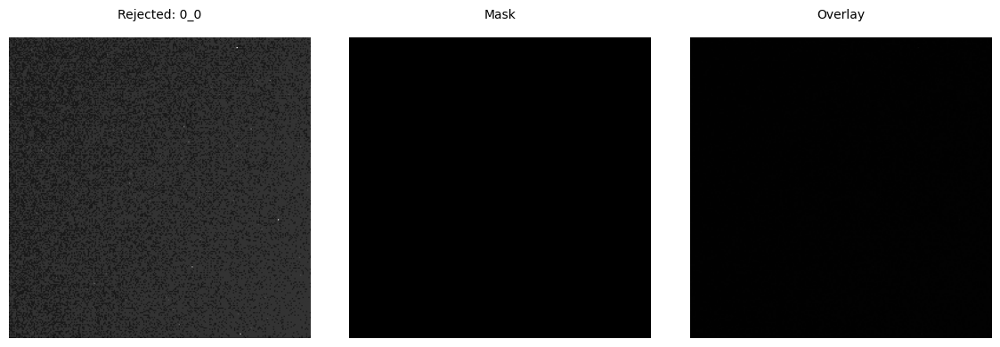

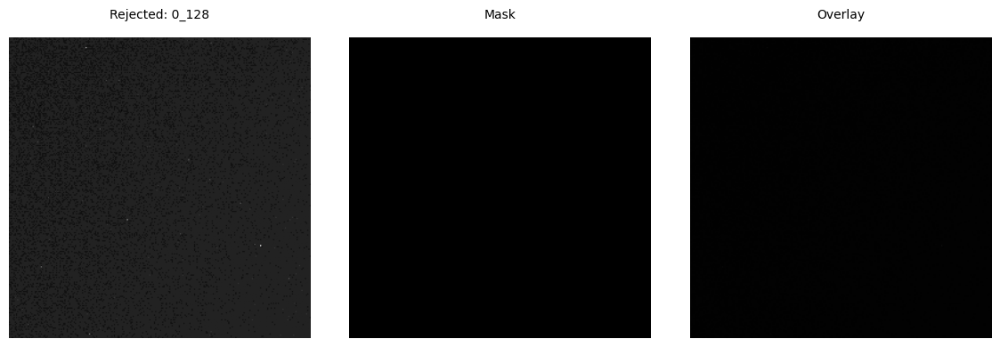

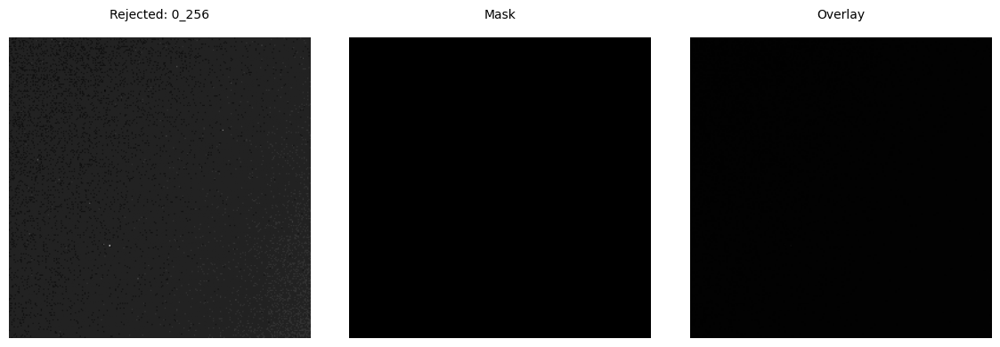

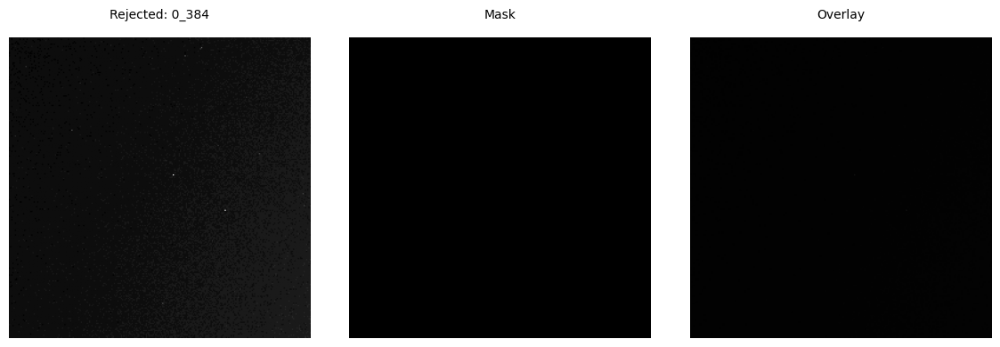

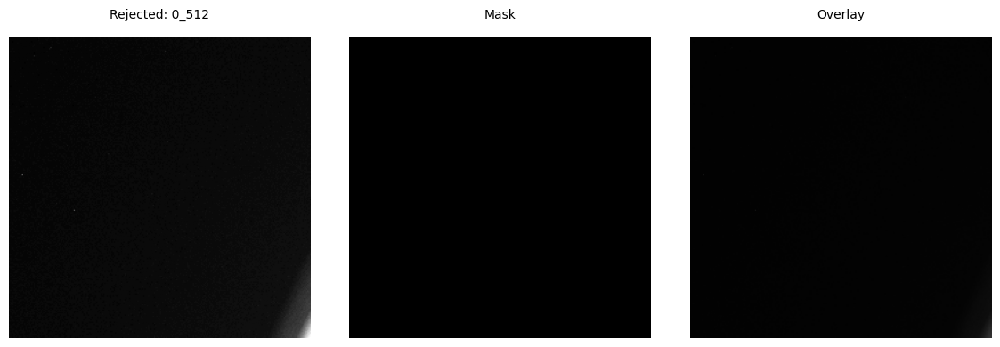

Checking image: 001_43-6-ROOT1-2023-08-08_pvdCherry_OD001_Col0_04-Fish Eye Corrected.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: 002_43-19-ROOT1-2023-08-08_pvd_OD001_Col0_01-Fish Eye Corrected.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: 002_43-6-ROOT1-2023-08-08_pvd_OD001_Col0_01-Fish Eye Corrected.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: 003_43-18-ROOT1-2023-08-08_pvdCherry_OD01_f6h1_01-Fish Eye Corrected.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: 003_43-6-ROOT1-2023-08-08_pvd_OD0001_f6h1_03-Fish Eye Corrected.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: 004_43-11-ROOT1-2023-08-08_pvdCherry_OD0001_f6h1_03-Fish Eye Corrected.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: 004_43-17-ROOT1-2023-08-08_pvd_OD001_f6h1_04-Fish Eye Corrected.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: 005_43-18-ROOT1-

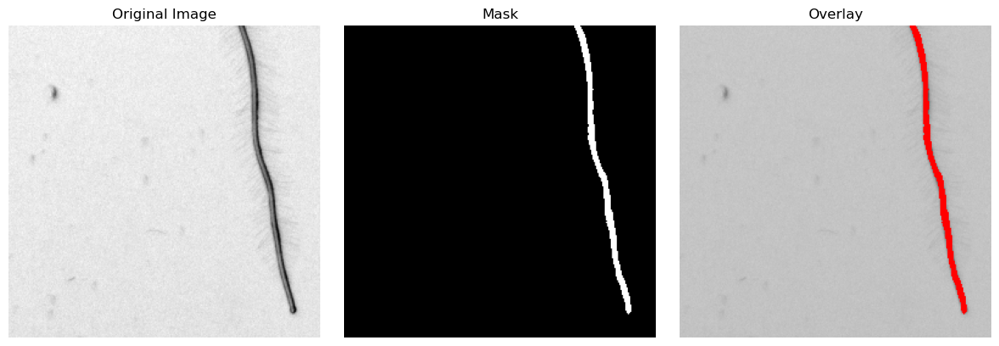

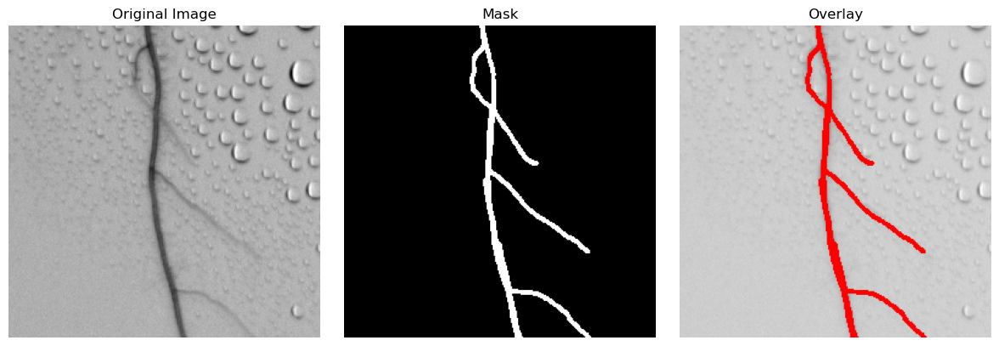

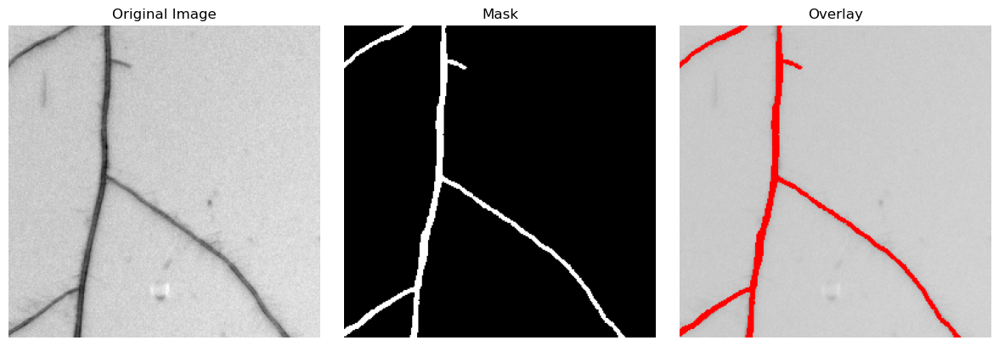

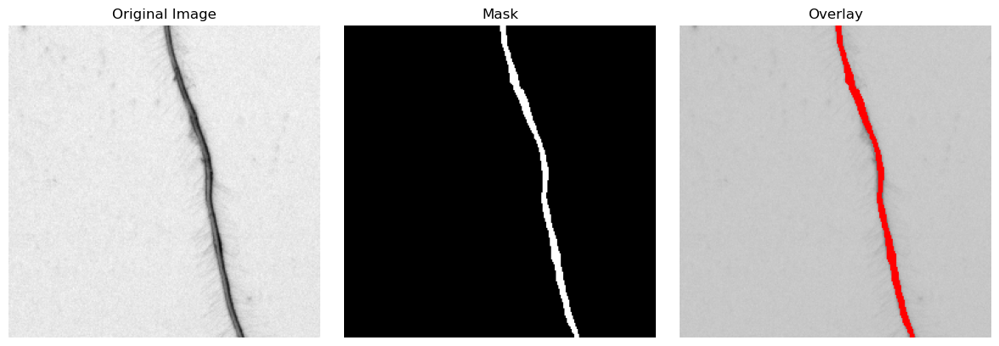

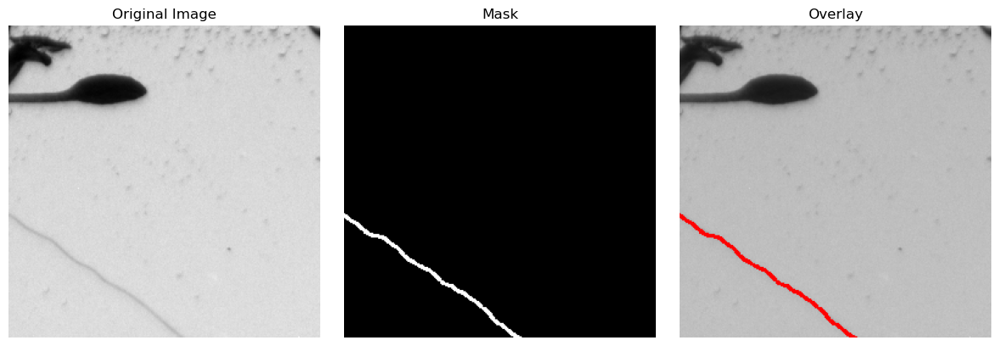

In [31]:
patch_and_save_filtered_with_preview(
    image_dir="dataset_23/train_images/train",
    mask_dir="dataset_23/train_masks/train",
    out_img_dir="tuned_patched_dataset_23/train_images/train",
    out_mask_dir="tuned_patched_dataset_23/train_masks/train",
    patch_size=256,
    stride=128,
    visualize=True,
)

In [193]:
# Sanity check
# no unwanted masks
# no orphan images

paths = {
    "train_images": Path("tuned_patched_dataset_23/train_images/train"),
    "train_masks": Path("tuned_patched_dataset_23/train_masks/train"),
}

# Allowed suffixes
allowed_mask_suffixes = [".tif"]

# Run check for train split
check_folder(paths["train_images"], paths["train_masks"], "train")


Checking TRAIN set...
No unwanted mask types found.
All images have at least one corresponding root mask.
9985 images, 9985 masks.



Showing 5 patches from image: 005_43-18-ROOT1-2023-08-08_pvd_OD001_Col0_05-Fish Eye Corrected


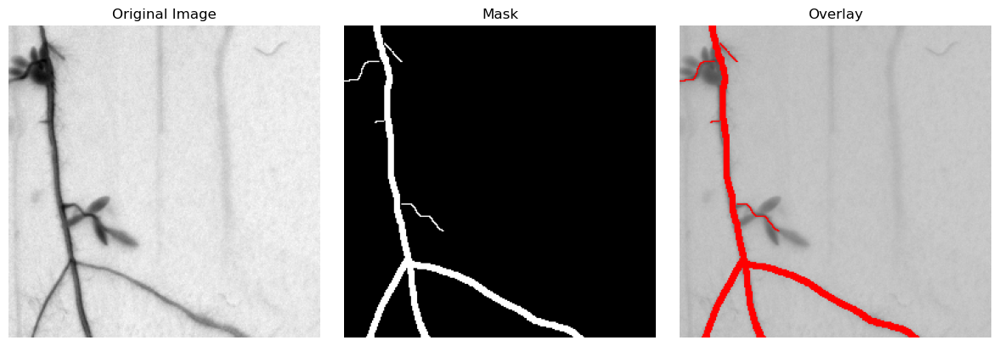

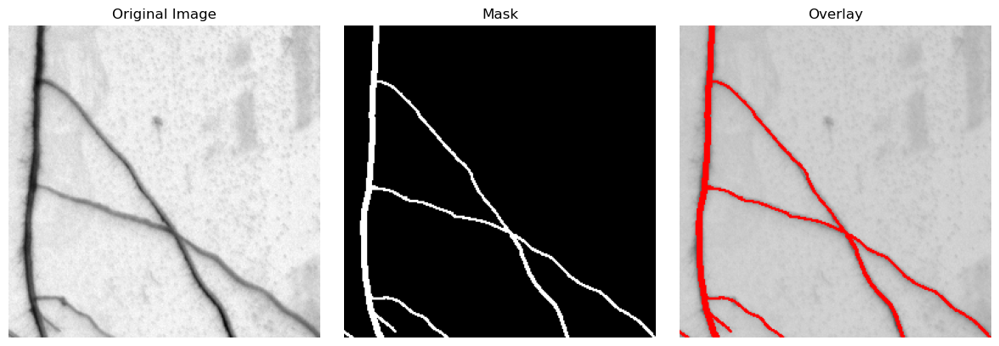

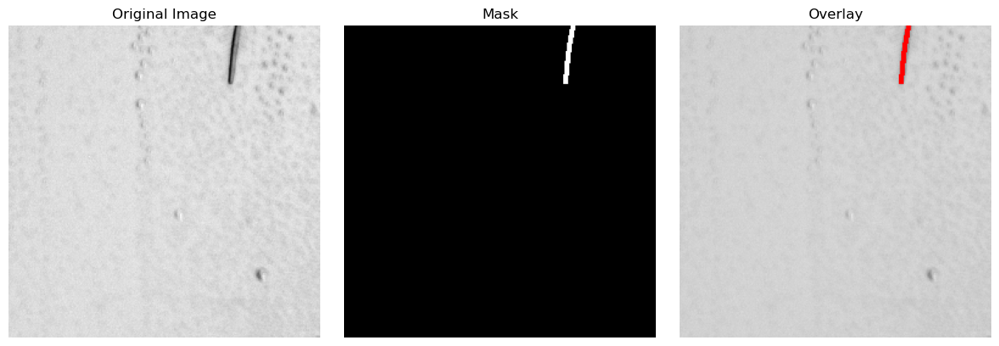

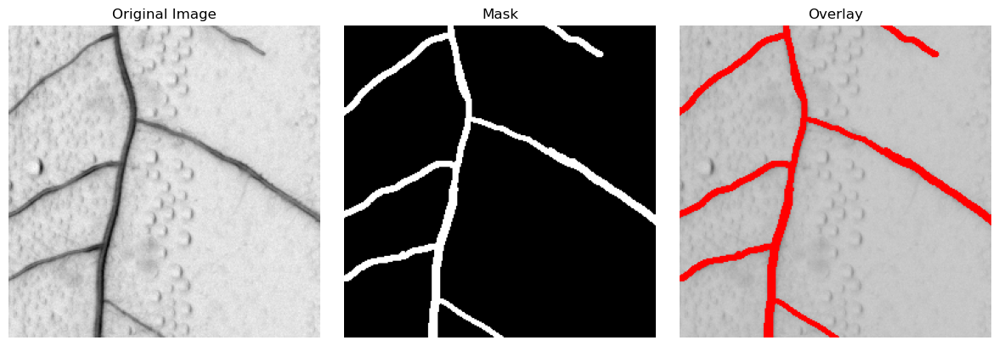

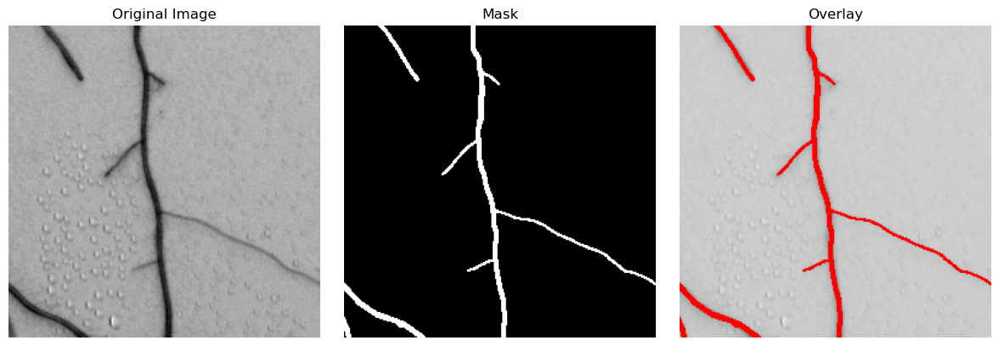

In [194]:
visualize_random_patches(
    image_dir="tuned_patched_dataset_23/train_images/train",
    mask_dir="tuned_patched_dataset_23/train_masks/train",
    num_patches=5, min_mask_pixels=10
)

### Root Densities

We will plot the root densities for the simple and automated filtered datasets in order to observe if the tuned dataset had better results and to decide which one will be part of the final dataset.

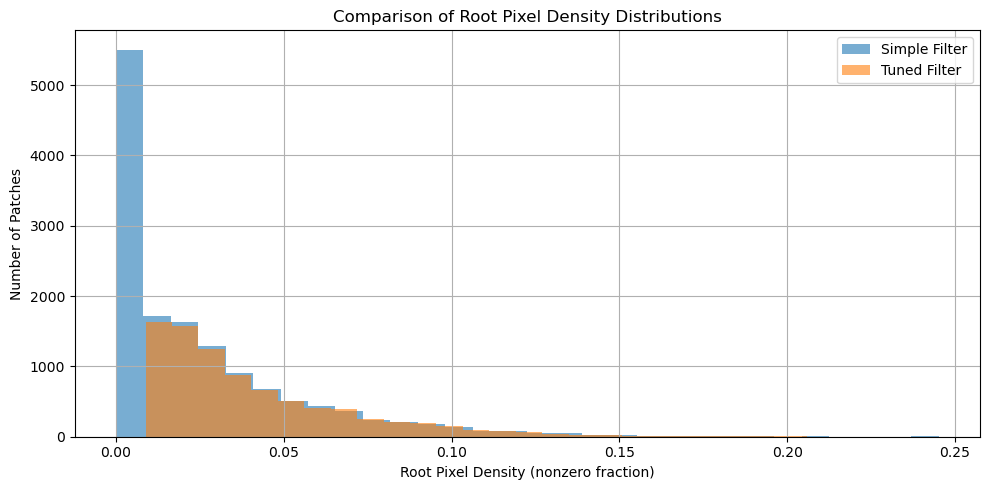

Mean density (simple): 0.0251
Mean density (tuned) : 0.0409


In [57]:
def compute_root_densities(mask_dir, extension=".tif"):
    """
    Computes root pixel densities for all mask patches in a directory.
    """
    densities = []
    mask_files = sorted([f for f in Path(mask_dir).glob(f"*{extension}") if not f.name.startswith("._")])
    
    for mask_path in mask_files:
        mask = np.array(Image.open(mask_path).convert("L"))
        density = np.count_nonzero(mask) / mask.size
        densities.append(density)
    
    return densities

simple_mask_dir = Path("simple_filtered_patched_dataset_23/train_masks/train", density=True)
tuned_mask_dir = Path("tuned_patched_dataset_23/train_masks/train", density=True)

# Compute densities
simple_densities = compute_root_densities(simple_mask_dir)
tuned_densities = compute_root_densities(tuned_mask_dir)

# === Plot Histograms ===
plt.figure(figsize=(10, 5))
plt.hist(simple_densities, bins=30, alpha=0.6, label="Simple Filter")
plt.hist(tuned_densities, bins=30, alpha=0.6, label="Tuned Filter")
plt.xlabel("Root Pixel Density (nonzero fraction)")
plt.ylabel("Number of Patches")
plt.title("Comparison of Root Pixel Density Distributions")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Print mean densities
print(f"Mean density (simple): {np.mean(simple_densities):.4f}")
print(f"Mean density (tuned) : {np.mean(tuned_densities):.4f}")


The tuned filtering approach for the 2023 dataset has a clear advantage over the simple fixed-threshold method. While both filters retain patches with moderate to high root pixel densities, the tuned filter appears to be more effective at creating a smaller, more focused dataset by significantly reducing the number of near-empty patches compared to the simple filter. While the simple filter produced a larger number of patches, it included a massive volume of uninformative, near-empty images, resulting in a low mean root density of 0.0251. The tuned filter approach, however, discarded these empty patches, yielding a smaller dataset that is more concentrated with relevant root structures. This is confirmed by its much higher mean root density of 0.0409, making it the superior choice for training a robust and accurate machine learning model.

### Inspect extra tuned patches

We will plot some tuned-only patches and simple-only patches to compare and perform a simple qualitative evaluation.

In [53]:
def load_gray(path):
    return cv2.imread(str(path), cv2.IMREAD_GRAYSCALE)

def hybrid_filter(mask_patch, min_ratio, min_area):
    ratio = np.count_nonzero(mask_patch) / mask_patch.size
    labeled, num = label(mask_patch > 0)
    sizes = [(labeled == i).sum() for i in range(1, num + 1)]
    return ratio >= min_ratio and any(area >= min_area for area in sizes)

def debug_filter_comparison(img_path, mask_path, patch_size=256, stride=128,
                             simple_params=None, tuned_params=None, max_visualize=5):
    assert simple_params and tuned_params, "Filtering parameters must be provided."

    image = load_gray(img_path)
    mask = load_gray(mask_path)
    if image is None or mask is None:
        print("Could not load image or mask.")
        return

    H, W = image.shape[:2]
    total = 0
    simple_only = 0
    tuned_only = 0
    both = 0

    for y in range(0, H - patch_size + 1, stride):
        for x in range(0, W - patch_size + 1, stride):
            img_patch = image[y:y+patch_size, x:x+patch_size]
            mask_patch = mask[y:y+patch_size, x:x+patch_size]

            passes_simple = hybrid_filter(mask_patch, **simple_params)
            passes_tuned = hybrid_filter(mask_patch, **tuned_params)
            total += 1

            category = None
            if passes_simple and passes_tuned:
                both += 1
            elif passes_simple:
                simple_only += 1
                category = "Simple Only"
            elif passes_tuned:
                tuned_only += 1
                category = "Tuned Only"

            if category and max_visualize > 0:
                overlay = cv2.cvtColor(img_patch, cv2.COLOR_GRAY2BGR)
                overlay[mask_patch > 0] = [255, 0, 0]
                fig, axs = plt.subplots(1, 3, figsize=(8, 4))
                axs[0].imshow(img_patch, cmap="gray")
                axs[0].set_title(category)
                axs[1].imshow(mask_patch, cmap="gray")
                axs[1].set_title("Mask")
                axs[2].imshow(overlay)
                axs[2].set_title("Overlay")
                for ax in axs: ax.axis("off")
                plt.tight_layout()
                plt.show()
                max_visualize -= 1

    print(f"\nSUMMARY: total={total}, tuned_only={tuned_only}, simple_only={simple_only}, both={both}")

In [58]:
best_params

{'min_ratio': 0.0012796844053026945, 'min_area': 78}

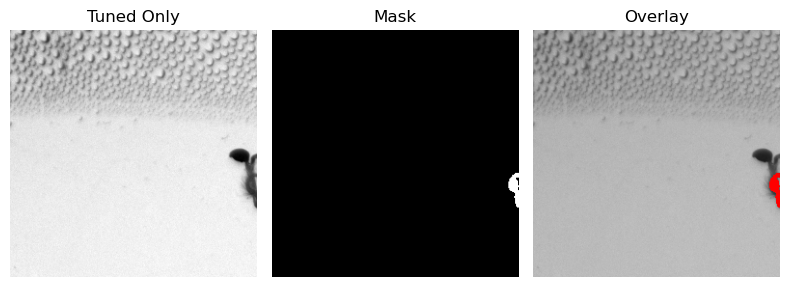

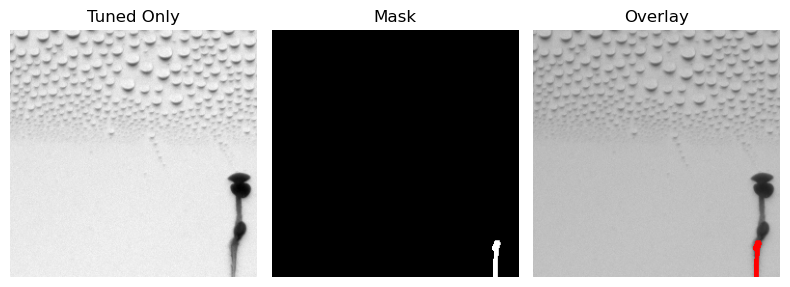

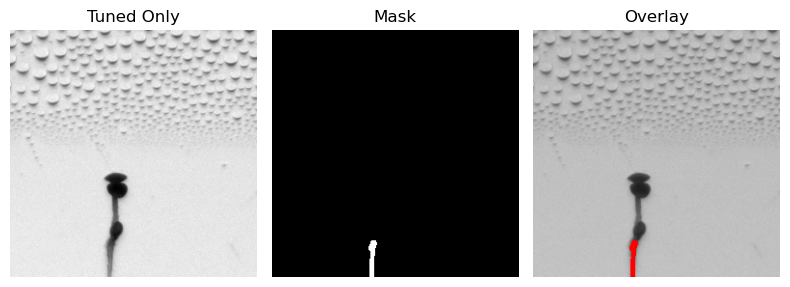


SUMMARY: total=682, tuned_only=17, simple_only=0, both=15


In [59]:
debug_filter_comparison(
    img_path="dataset_23/train_images/train/001_43-6-ROOT1-2023-08-08_pvdCherry_OD001_Col0_04-Fish Eye Corrected.png",
    mask_path="dataset_23/train_masks/train/001_43-6-ROOT1-2023-08-08_pvdCherry_OD001_Col0_04-Fish Eye Corrected_root_mask.tif",
    patch_size=256,
    stride=128,
    simple_params={"min_ratio": 0.005, "min_area": 100},
    tuned_params=best_params,
    max_visualize=3
)


This visual inspection confirms that the tuned filter captures meaningful root structures that the simple filter consistently misses. The patches shown as "Tuned Only" clearly contain valid root content. These roots are often faint, small, or peripheral—precisely the types of features the simple filter is prone to discard due to stricter area or density thresholds. Meanwhile, the absence of any “Simple Only” patches in this sample highlights the conservative nature of the simple filter: it rarely admits patches that the tuned filter wouldn’t already accept. Overall, this supports the conclusion that the tuned filter enhances dataset richness by inclusively capturing subtle root structures without adding noise.

### Y2B_24 dataset

In [46]:
def objective(trial):
    min_ratio = trial.suggest_float("min_ratio", 0.001, 0.02, log=True) # log scaled
    min_area = trial.suggest_int("min_area", 20, 150) # integer

    return evaluate_filter_config(
        patch_mask_dir="patched_dataset_24/train_masks/train",
        min_ratio=min_ratio,
        min_area=min_area,
    )


# Run study
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)

# Results
best_params = study.best_params
print("Best parameters:", best_params)
print("Best score:", study.best_value)

study.trials_dataframe()


[I 2025-08-14 07:44:00,496] A new study created in memory with name: no-name-408b174e-eddd-4503-9274-085c7b18f00c
[I 2025-08-14 07:44:01,457] Trial 0 finished with value: 0.0 and parameters: {'min_ratio': 0.008635101571664746, 'min_area': 90}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:44:01,591] Trial 1 finished with value: 0.0 and parameters: {'min_ratio': 0.006685850509158859, 'min_area': 27}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:44:01,707] Trial 2 finished with value: 0.0 and parameters: {'min_ratio': 0.0036977930400543405, 'min_area': 62}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:44:01,838] Trial 3 finished with value: 0.0 and parameters: {'min_ratio': 0.001499885593193546, 'min_area': 46}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:44:01,956] Trial 4 finished with value: 0.0 and parameters: {'min_ratio': 0.007171387622641684, 'min_area': 70}. Best is trial 0 with value: 0.0.
[I 2025-08-14 07:44:02,073] Trial 5 finished with value: 0.0 and param

Best parameters: {'min_ratio': 0.008635101571664746, 'min_area': 90}
Best score: 0.0


,number,value,datetime_start,datetime_complete,duration,params_min_area,params_min_ratio,state
0,0,0.0,2025-08-14 07:44:00.497365,2025-08-14 07:44:01.457039,0 days 00:00:00.959674,90,0.008635,COMPLETE
1,1,0.0,2025-08-14 07:44:01.457039,2025-08-14 07:44:01.591871,0 days 00:00:00.134832,27,0.006686,COMPLETE
2,2,0.0,2025-08-14 07:44:01.592724,2025-08-14 07:44:01.707204,0 days 00:00:00.114480,62,0.003698,COMPLETE
3,3,0.0,2025-08-14 07:44:01.707204,2025-08-14 07:44:01.838913,0 days 00:00:00.131709,46,0.001500,COMPLETE
4,4,0.0,2025-08-14 07:44:01.839983,2025-08-14 07:44:01.956996,0 days 00:00:00.117013,70,0.007171,COMPLETE
5,5,0.0,2025-08-14 07:44:01.956996,2025-08-14 07:44:02.073711,0 days 00:00:00.116715,96,0.004010,COMPLETE
6,6,0.0,2025-08-14 07:44:02.073711,2025-08-14 07:44:02.206918,0 days 00:00:00.133207,128,0.018053,COMPLETE
7,7,0.0,2025-08-14 07:44:02.206918,2025-08-14 07:44:02.333727,0 days 00:00:00.126809,92,0.014063,COMPLETE
8,8,0.0,2025-08-14 07:44:02.335730,2025-08-14 07:44:02.457023,0 days 00:00:00.121293,76,0.019149,COMPLETE
9,9,0.0,2025-08-14 07:44:02.457023,2025-08-14 07:44:02.573614,0 days 00:00:00.116591,95,0.012144,COMPLETE


Checking image: train_Alican_212231_im1.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)

Showing 5 rejected patches:


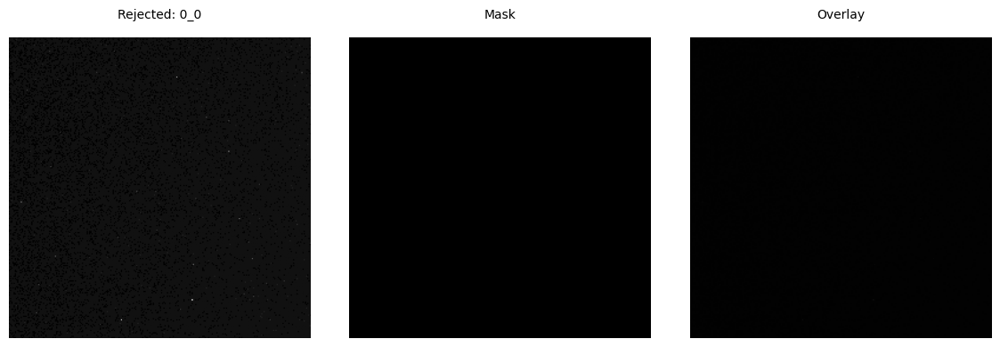

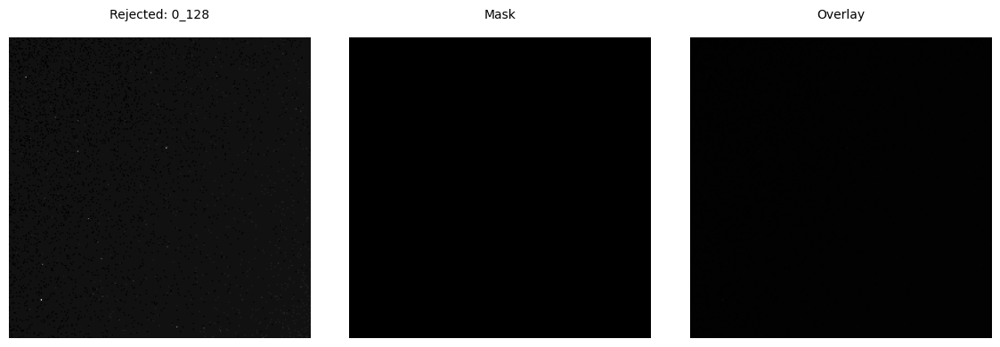

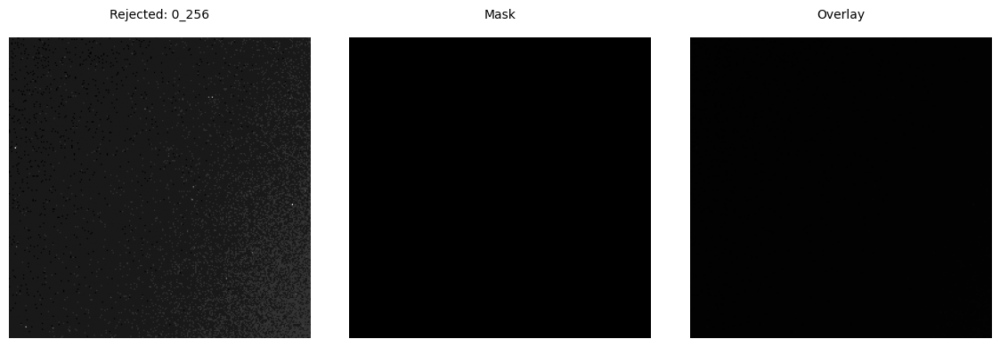

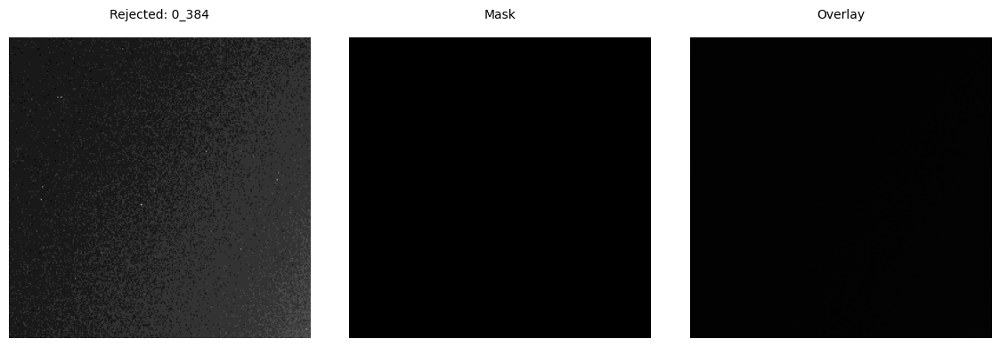

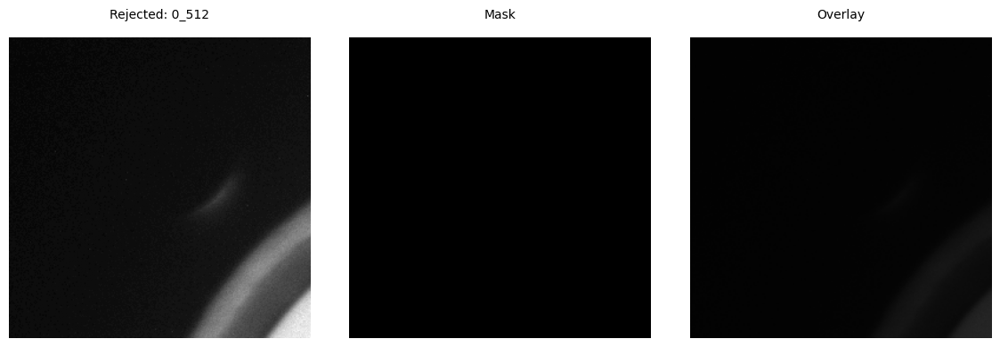

Checking image: train_Alican_212231_im3.png
Image shape: (3006, 4112), Mask shape: (3006, 4112)
Checking image: train_Alican_212231_im4.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: train_Alican_212231_im5.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: train_Alican_230858_im2.png
Image shape: (3006, 4112), Mask shape: (3006, 4112)
Checking image: train_Alican_230858_im3.png
Image shape: (3006, 4112), Mask shape: (3006, 4112)
Checking image: train_Alican_230858_im4.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: train_Alican_230858_im5.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: train_Alican_231131_im3.png
Image shape: (3006, 4112), Mask shape: (3006, 4112)
Checking image: train_Alican_231131_im4.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: train_Alican_231131_im5.png
Image shape: (3006, 4202), Mask shape: (3006, 4202)
Checking image: train_Alican_231648_im1.

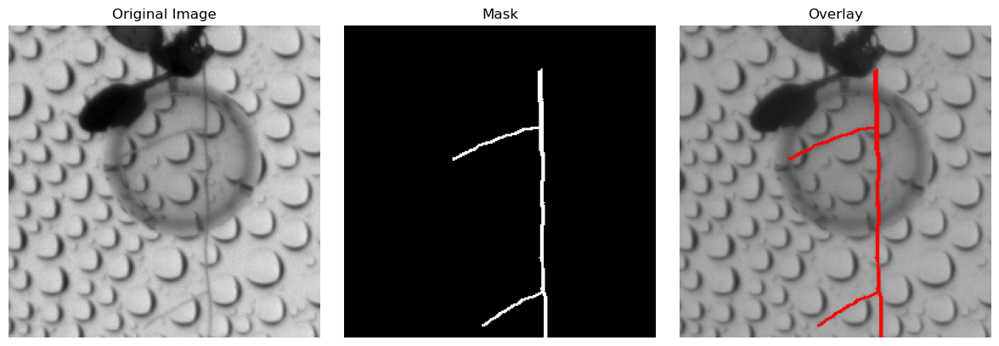

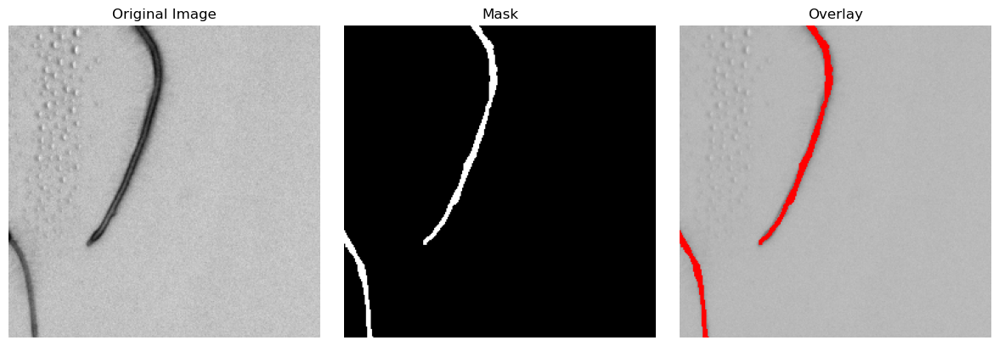

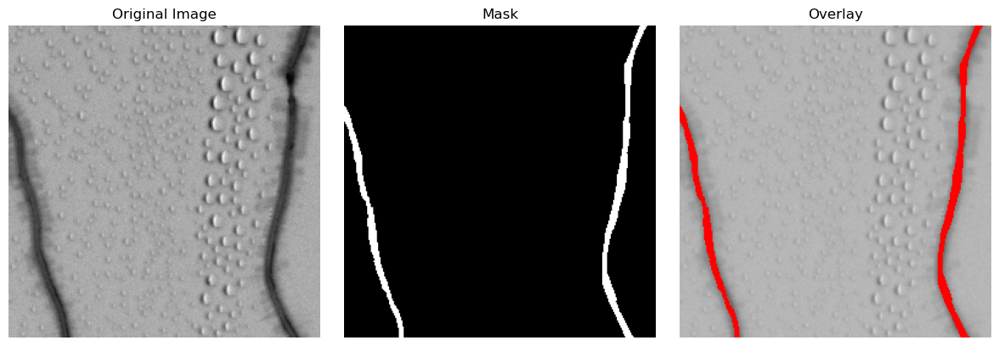

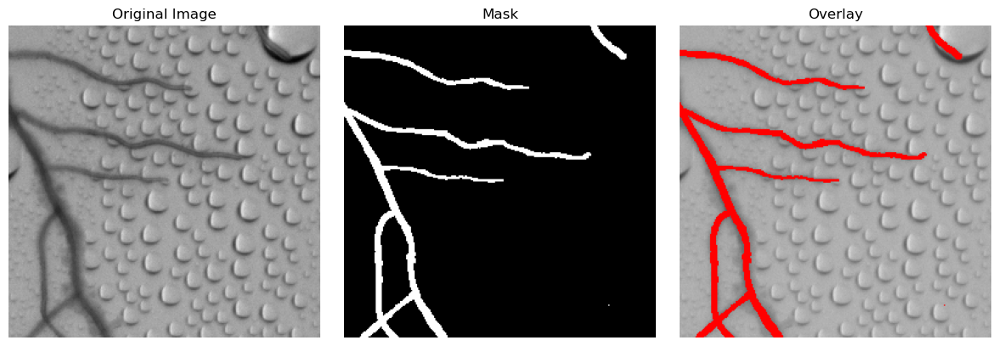

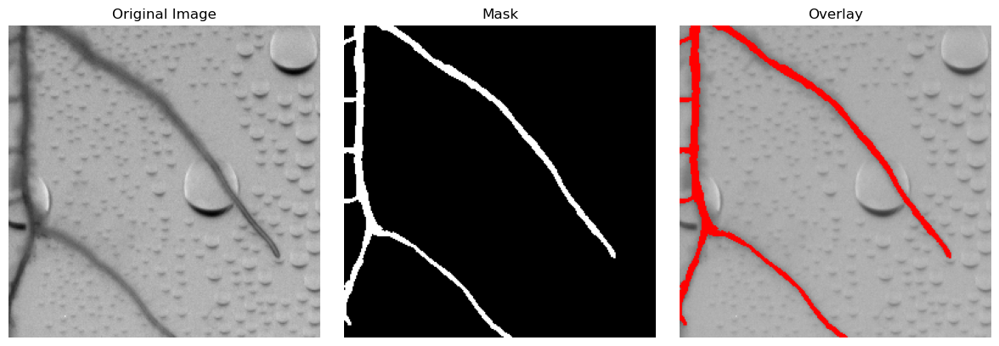

In [47]:
patch_and_save_filtered_with_preview(
    image_dir="dataset_24/train_images/train",
    mask_dir="dataset_24/train_masks/train",
    out_img_dir="tuned_patched_dataset_24/train_images/train",
    out_mask_dir="tuned_patched_dataset_24/train_masks/train",
    patch_size=256,
    stride=128,
    visualize=True
)

In [201]:
# Sanity check
# no unwanted masks
# no orphan images

paths = {
    "train_images": Path("tuned_patched_dataset_24/train_images/train"),
    "train_masks": Path("tuned_patched_dataset_24/train_masks/train"),
}

# Allowed suffixes
allowed_mask_suffixes = [".tif"]

# Run check for train split
check_folder(paths["train_images"], paths["train_masks"], "train")


Checking TRAIN set...
No unwanted mask types found.
All images have at least one corresponding root mask.
16627 images, 16627 masks.



Showing 5 patches from image: train_Dean_221846_im3


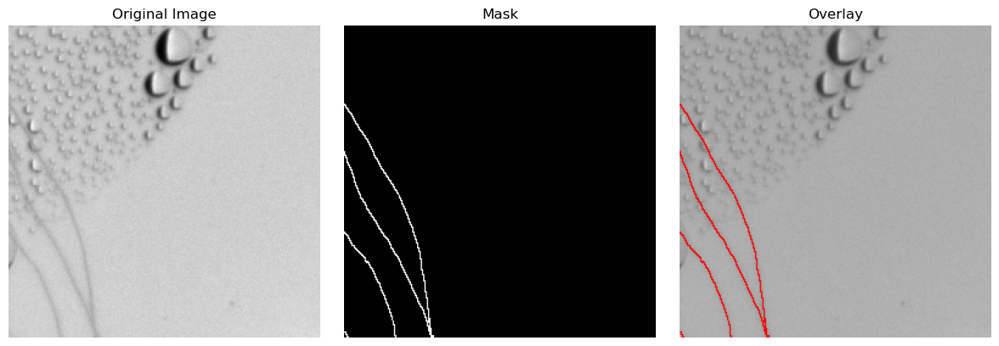

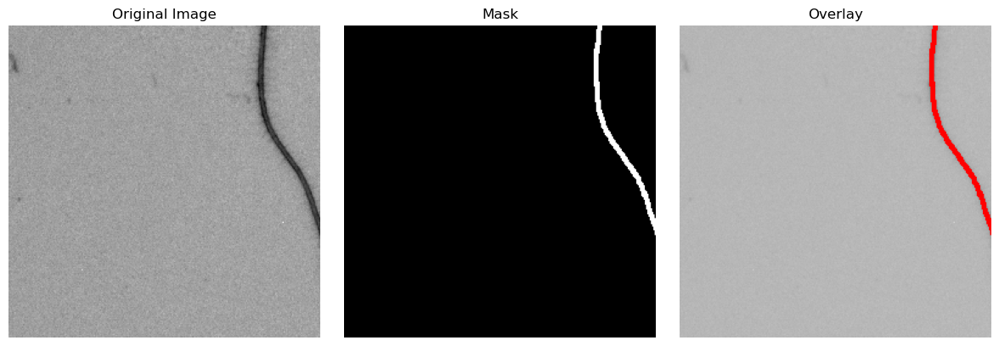

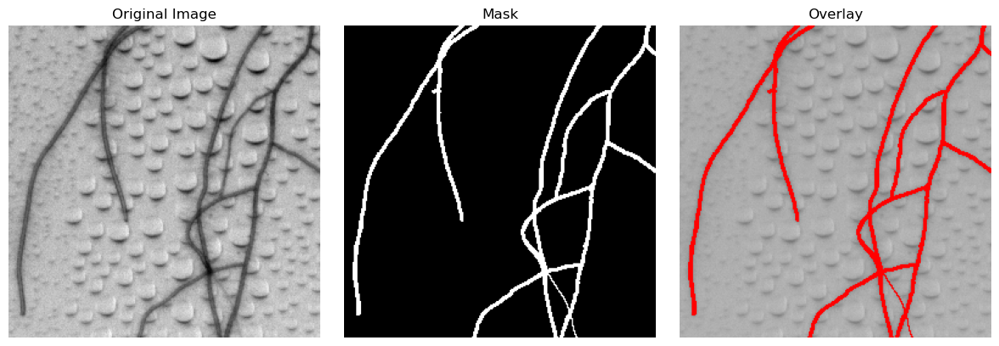

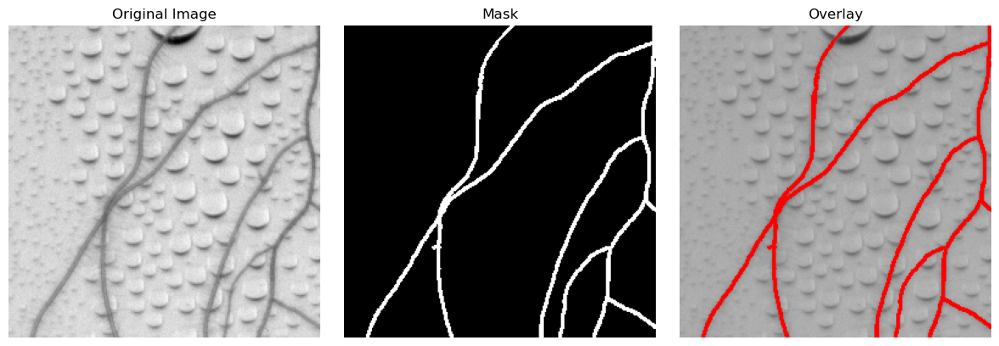

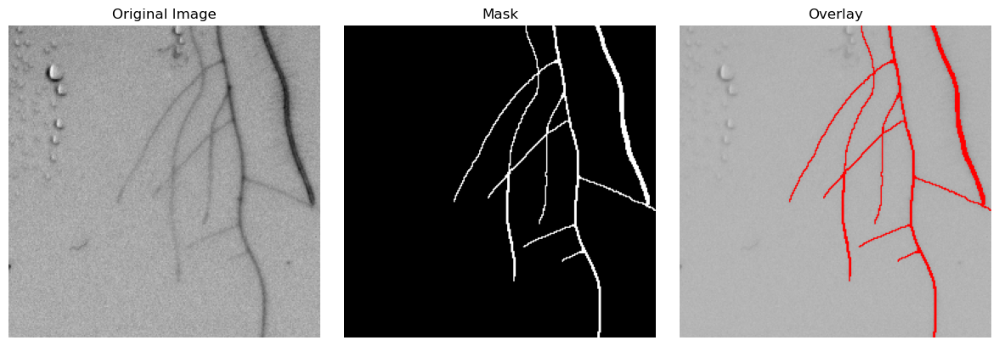

In [202]:
visualize_random_patches(
    image_dir="tuned_patched_dataset_24/train_images/train",
    mask_dir="tuned_patched_dataset_24/train_masks/train",
    num_patches=5, min_mask_pixels=10
)

### Root Densities

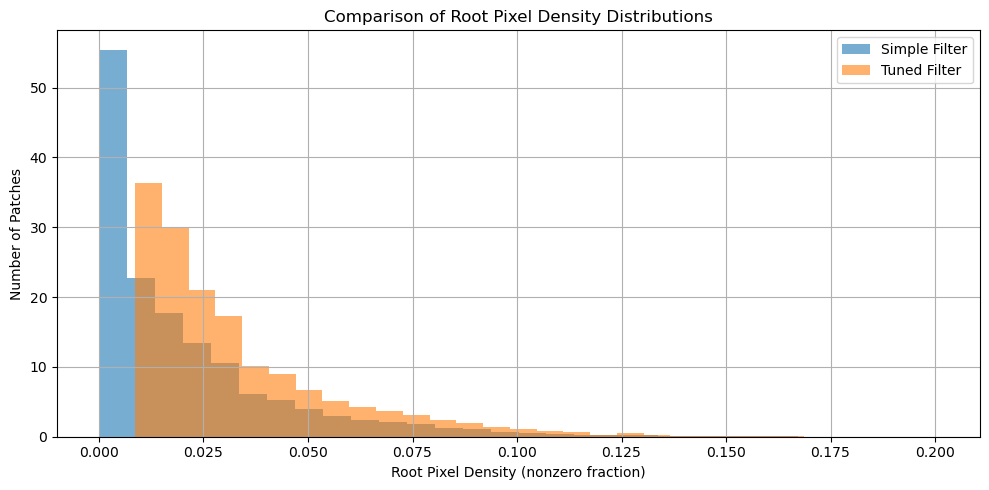

Mean density (simple): 0.0198
Mean density (tuned) : 0.0329


In [49]:
simple_mask_dir = Path("simple_filtered_patched_dataset_24/train_masks/train")
tuned_mask_dir = Path("tuned_patched_dataset_24/train_masks/train")

# Compute densities
simple_densities = compute_root_densities(simple_mask_dir)
tuned_densities = compute_root_densities(tuned_mask_dir)

# === Plot Histograms ===
plt.figure(figsize=(10, 5))
plt.hist(simple_densities, bins=30, alpha=0.6, label="Simple Filter", density=True)
plt.hist(tuned_densities, bins=30, alpha=0.6, label="Tuned Filter", density=True)
plt.xlabel("Root Pixel Density (nonzero fraction)")
plt.ylabel("Number of Patches")
plt.title("Comparison of Root Pixel Density Distributions")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Print mean densities
print(f"Mean density (simple): {np.mean(simple_densities):.4f}")
print(f"Mean density (tuned) : {np.mean(tuned_densities):.4f}")

For the 2024 dataset, the tuned filter shows a notably broader and more evenly distributed capture of patches across the range of root pixel densities. The histogram reveals that while the simple filter tends to concentrate around very low densities (with a peak near 0.01), the tuned filter selects more patches in the medium-density range (0.02–0.1), contributing to a higher mean density overall (0.0370 vs. 0.0265). This indicates that the tuned filter is more sensitive to moderate root content, likely allowing patches that would otherwise be excluded by the stricter fixed threshold of the simple filter. The tuned filter appears to be more effective at prioritizing biologically meaningful regions with substantial—but not overly dense—root structures, potentially improving the informativeness and variability of the training data.

### Inspect extra tuned patches

In [51]:
best_params

{'min_ratio': 0.008635101571664746, 'min_area': 90}

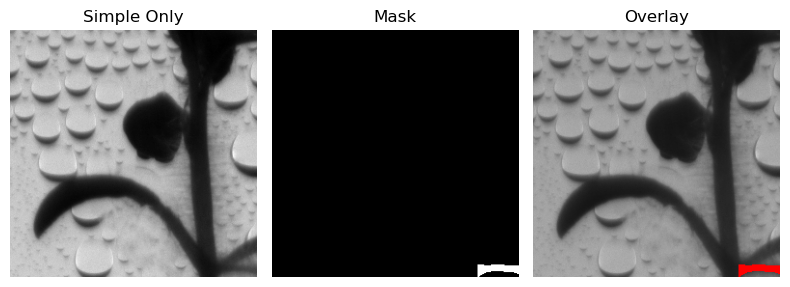

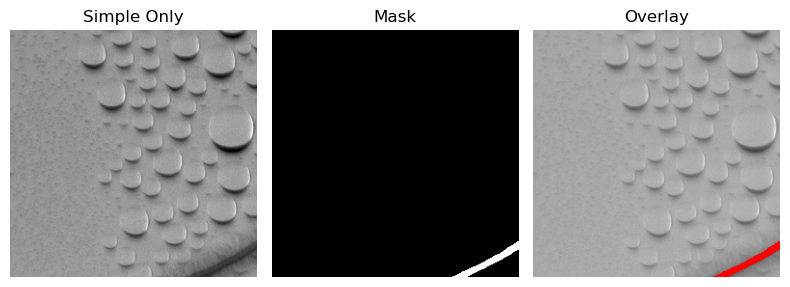

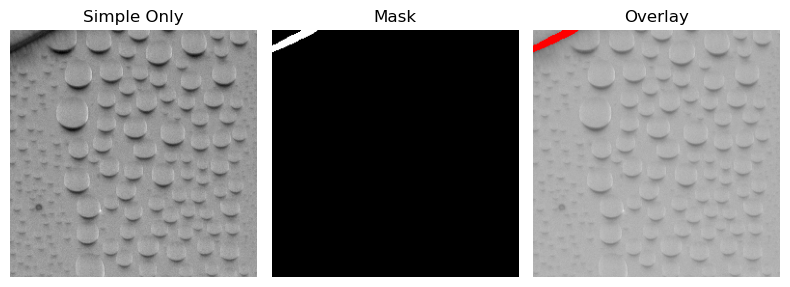


SUMMARY: total=682, tuned_only=0, simple_only=5, both=61


In [54]:
debug_filter_comparison(
    img_path="dataset_24/train_images/train/train_Alican_212231_im1.png",
    mask_path="dataset_24/train_masks/train/train_Alican_212231_im1_root_mask.tif",
    patch_size=256,
    stride=128,
    simple_params={"min_ratio": 0.005, "min_area": 100},
    tuned_params=best_params,
    max_visualize=3
)

Visual inspection of the patches filtered only by the simple criteria reveals that they mostly contain very small, peripheral root segments—often thin, fragmented, or positioned near the image edges. While the simple filter captures these low-density or partial structures, the tuned filter excludes them due to its stricter area threshold or slightly lower density tolerance. This is corroborated by the histogram, where the simple filter leans heavily toward very low-density patches. Though this might slightly increase data quantity, the retained patches may not provide significant learning value. Overall, the tuned filter prioritizes higher-quality, more complete root structures, suggesting it favors informativeness over quantity.

### Adding the val folders back
In the process of processing the patches in the step above, the validation folders were not copied. We will copy them, in their respective datasets.

In [20]:
def copy_val_folders(src_root, dst_root):
    val_img_src = Path(src_root) / "val_images" / "val"
    val_mask_src = Path(src_root) / "val_masks" / "val"
    val_img_dst = Path(dst_root) / "val_images" / "val"
    val_mask_dst = Path(dst_root) / "val_masks" / "val"

    if val_img_src.exists():
        shutil.copytree(val_img_src, val_img_dst, dirs_exist_ok=True)
        print(f"Copied validation images from {val_img_src} to {val_img_dst}")
    else:
        print(f"Could not find {val_img_src}")

    if val_mask_src.exists():
        shutil.copytree(val_mask_src, val_mask_dst, dirs_exist_ok=True)
        print(f"Copied validation masks from {val_mask_src} to {val_mask_dst}")
    else:
        print(f"Could not find {val_mask_src}")

In [34]:
copy_val_folders("patched_dataset_24", "tuned_patched_dataset_24")

Copied validation images from patched_dataset_24\val_images\val to tuned_patched_dataset_24\val_images\val
Copied validation masks from patched_dataset_24\val_masks\val to tuned_patched_dataset_24\val_masks\val


## Combining datasets: tuned_dataset

In [50]:
merge_datasets(
    src1="tuned_patched_dataset_23",
    src2="tuned_patched_dataset_24",
    dest="tuned_dataset",
    include_val_from="tuned_patched_dataset_24"
)

Merged training data from tuned_patched_dataset_23 and tuned_patched_dataset_24 into tuned_dataset
Included validation set from tuned_patched_dataset_24


## Data augmentation

We will augment the training data using classic and safe methods such as:
- Horizontal/ vertical flips;
- Rotations;
- Random rotations at 90 degrees;
- Shifts, scales;
- Brightness contrast.

In [60]:
# Define augmentation
augmentation = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.2),
    A.RandomRotate90(p=0.5),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=20, p=0.5),
    A.RandomBrightnessContrast(p=0.3),
], additional_targets={'mask': 'mask'})

def apply_augmentations(input_img_dir, input_mask_dir, output_img_dir, output_mask_dir, num_aug_per_image=2):
    Path(output_img_dir).mkdir(parents=True, exist_ok=True)
    Path(output_mask_dir).mkdir(parents=True, exist_ok=True)

    image_files = sorted([f for f in Path(input_img_dir).glob("*.png") if not f.name.startswith("._")])
    print(f"Augmenting {len(image_files)} images...")

    for img_path in image_files:
        stem = img_path.stem
        mask_path = Path(input_mask_dir) / f"{stem}.tif"
        if not mask_path.exists():
            print(f"Skipping {stem} (no mask found)")
            continue

        image = cv2.imread(str(img_path), cv2.IMREAD_GRAYSCALE)
        mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)

        # Save original
        Image.fromarray(image).save(Path(output_img_dir) / f"{stem}.png")
        Image.fromarray(mask).save(Path(output_mask_dir) / f"{stem}.tif")

        # Generate augmented versions
        for i in range(num_aug_per_image):
            augmented = augmentation(image=image, mask=mask)
            aug_img = augmented['image']
            aug_mask = augmented['mask']

            Image.fromarray(aug_img).save(Path(output_img_dir) / f"{stem}_aug{i}.png")
            Image.fromarray(aug_mask).save(Path(output_mask_dir) / f"{stem}_aug{i}.tif")

    print(f"Done. Saved augmented images to {output_img_dir} and {output_mask_dir}")

c:\Users\dari\anaconda3\envs\block_b\lib\site-packages\albumentations\core\validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


In [61]:
apply_augmentations(
    input_img_dir="tuned_dataset/train_images/train",
    input_mask_dir="tuned_dataset/train_masks/train",
    output_img_dir="augmented_dataset/train_images/train",
    output_mask_dir="augmented_dataset/train_masks/train",
    num_aug_per_image=2
)

Augmenting 22763 images...
Done. Saved augmented images to augmented_dataset/train_images/train and augmented_dataset/train_masks/train


### Adding the val folders back
In the process of processing the patches in the step above, the validation folders were not copied. We will copy them, in their respective datasets.

In [63]:
copy_val_folders("tuned_dataset", "augmented_dataset")

Copied validation images from tuned_dataset\val_images\val to augmented_dataset\val_images\val
Copied validation masks from tuned_dataset\val_masks\val to augmented_dataset\val_masks\val


# Iteration 2 - Balancing the dataset

After training the model on the resulting dataset, I realised that removing all background patches is not a good idea as the model doesn't have any background context. Here, I balanced it by partially (1 background patch per 2 root-rich patches) keeping patches that were classified as 'background'. I will only use automated tuning because it is a more robust solution. I will not apply data augmentation yet, as I want to test out if based on my logic, the F1 will improve.

## 2023 dataset

In [64]:
def load_mask(path):
    return np.array(Image.open(path))


def compute_root_density(mask_patch):
    return np.count_nonzero(mask_patch) / mask_patch.size


def has_large_blob(mask_patch, min_area):
    labeled, num = label(mask_patch > 0)
    sizes = [(labeled == i).sum() for i in range(1, num + 1)]
    return any(area >= min_area for area in sizes)


def hybrid_filter(mask_patch, min_ratio, min_area):
    density = compute_root_density(mask_patch)
    return density >= min_ratio and has_large_blob(mask_patch, min_area)


def evaluate_filter_config(patch_mask_dir, min_ratio, min_area):
    mask_files = [f for f in Path(patch_mask_dir).glob("*.png") if not f.name.startswith("._")]
    densities = []
    skipped_border = 0
    kept = 0

    for f in mask_files:
        mask = load_mask(f)
        h, w = mask.shape

        name_parts = f.stem.split("_")
        try:
            y, x = int(name_parts[-2]), int(name_parts[-1])
        except ValueError:
            continue

        is_border = (x + 256 >= w) or (y + 256 >= h)
        keep = hybrid_filter(mask, min_ratio, min_area)

        if keep:
            densities.append(compute_root_density(mask))
            kept += 1
        elif is_border:
            skipped_border += 1

    if kept == 0:
        return 0.0  # penalize configs that discard everything

    mean_density = np.mean(densities)
    penalty = skipped_border / len(mask_files) if mask_files else 0
    return mean_density - penalty


def objective(trial):
    min_ratio = trial.suggest_float("min_ratio", 0.001, 0.02, log=True) # log scaled
    min_area = trial.suggest_int("min_area", 20, 150) # integer

    return evaluate_filter_config(
        patch_mask_dir="patched_dataset_23/train_masks/train",
        min_ratio=min_ratio,
        min_area=min_area,
    )


# Run study
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)

# Results
best_params = study.best_params
print("Best parameters:", best_params)
print("Best score:", study.best_value)

study.trials_dataframe()


# === FILTERING UTILITIES ===
def load_image(path):
    return cv2.imread(str(path), cv2.IMREAD_GRAYSCALE)

def save_patch(patch, path):
    Image.fromarray(patch).save(path)

def is_significant_ratio(mask_patch, min_ratio):
    return (np.count_nonzero(mask_patch) / mask_patch.size) >= min_ratio

def has_large_blob(mask_patch, min_area=100):
    labeled, num = label(mask_patch > 0)
    sizes = [(labeled == i).sum() for i in range(1, num + 1)]
    return any(area >= min_area for area in sizes)

def hybrid_filter(mask_patch, ratio_thresh, area_thresh):
    return is_significant_ratio(mask_patch, ratio_thresh) and has_large_blob(mask_patch, area_thresh)

def create_filtered_patches(img, mask, patch_size, stride, ratio_thresh, area_thresh):
    H, W = img.shape[:2]
    root_rich = []
    background = []

    for y in range(0, H - patch_size + 1, stride):
        for x in range(0, W - patch_size + 1, stride):
            img_patch = img[y:y+patch_size, x:x+patch_size]
            mask_patch = mask[y:y+patch_size, x:x+patch_size]

            if hybrid_filter(mask_patch, ratio_thresh, area_thresh):
                root_rich.append((img_patch, mask_patch))
            else:
                background.append((img_patch, mask_patch))

    return root_rich, background

# === PATCHING & VISUALIZATION ===
def patch_and_save_filtered_with_preview(image_dir, mask_dir, out_img_dir, out_mask_dir,
                                         patch_size=256, stride=128, visualize=True, sample_rejected=5):
    min_ratio = best_params["min_ratio"]
    min_area = best_params["min_area"]

    # Clean previous patches
    for d in [out_img_dir, out_mask_dir]:
        if Path(d).exists():
            shutil.rmtree(d)
        Path(d).mkdir(parents=True)

    image_files = sorted([f for f in Path(image_dir).glob("*.png") if not f.name.startswith("._")])
    saved = 0
    first_image_visualized = False

    for img_path in image_files:
        stem = img_path.stem
        possible_matches = list(Path(mask_dir).glob(f"{stem}_root_mask.tif"))
        if not possible_matches:
            print(f"Mask not found for: {stem}")
            continue

        mask_path = possible_matches[0]
        print(f"Checking image: {img_path.name}")

        if not mask_path.exists():
            print(f"Mask not found for: {stem}")
            continue

        img = load_image(img_path)
        mask = load_image(mask_path)

        print(f"Image shape: {img.shape}, Mask shape: {mask.shape}")
        root_rich, background = create_filtered_patches(
            img, mask, patch_size, stride,
            ratio_thresh=min_ratio,
            area_thresh=min_area
        )

        # Downsample background
        background_ratio = 0.5  # adjust as needed
        keep_n = int(len(root_rich) * background_ratio)
        random.shuffle(background)
        background = background[:keep_n]

        print(f"{len(root_rich)} root-rich, {len(background)} background patches from {img_path.name}")

        for patch_list in [root_rich, background]:
            for img_patch, mask_patch in patch_list:
                base = f"{stem}_{saved}"
                save_patch(img_patch, Path(out_img_dir) / f"{base}.png")
                save_patch(mask_patch, Path(out_mask_dir) / f"{base}.tif")
                saved += 1

        if not first_image_visualized:
            preview_patch_categories(root_rich, background, num_samples=3)
            first_image_visualized = True

    print(f"Saved {saved} filtered patches.")

    if visualize:
        visualize_random_patches(out_img_dir, out_mask_dir, num_patches=5, min_mask_pixels=10)

[I 2025-08-14 17:55:00,294] A new study created in memory with name: no-name-5c365f65-1cae-4798-8c63-3dc62a5724c1
[I 2025-08-14 17:55:00,727] Trial 0 finished with value: 0.0 and parameters: {'min_ratio': 0.0012767301128441223, 'min_area': 114}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:55:00,781] Trial 1 finished with value: 0.0 and parameters: {'min_ratio': 0.009440156577360734, 'min_area': 100}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:55:00,848] Trial 2 finished with value: 0.0 and parameters: {'min_ratio': 0.007488743464507237, 'min_area': 24}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:55:00,909] Trial 3 finished with value: 0.0 and parameters: {'min_ratio': 0.0013026687452245141, 'min_area': 144}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:55:00,963] Trial 4 finished with value: 0.0 and parameters: {'min_ratio': 0.013501606541676807, 'min_area': 99}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:55:01,017] Trial 5 finished with value: 0.0 and p

Best parameters: {'min_ratio': 0.0012767301128441223, 'min_area': 114}
Best score: 0.0


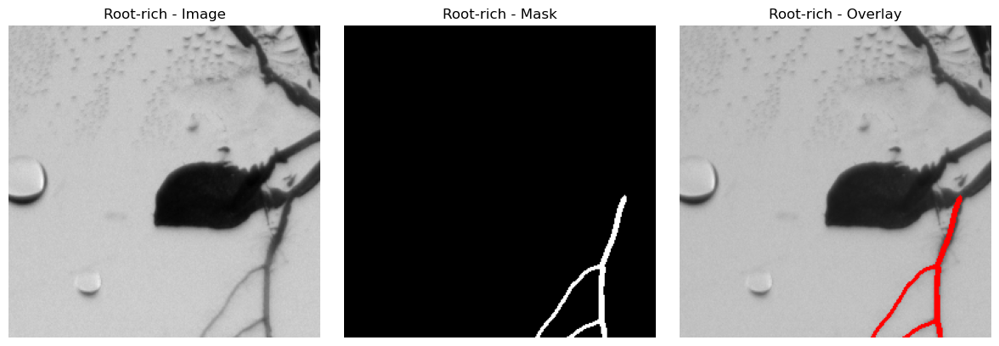

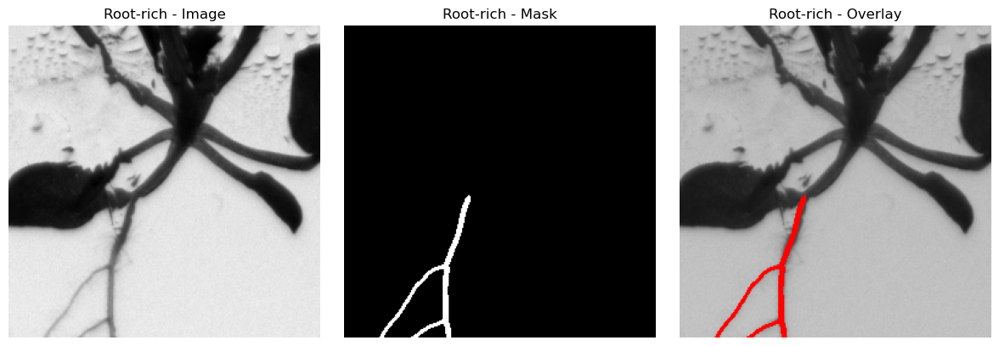

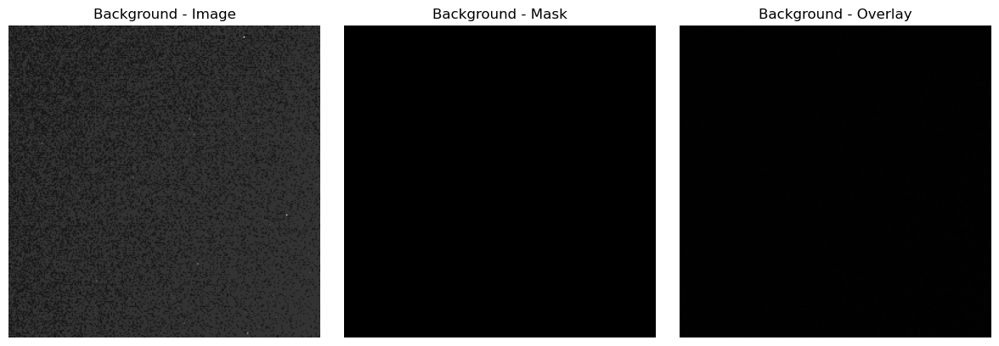

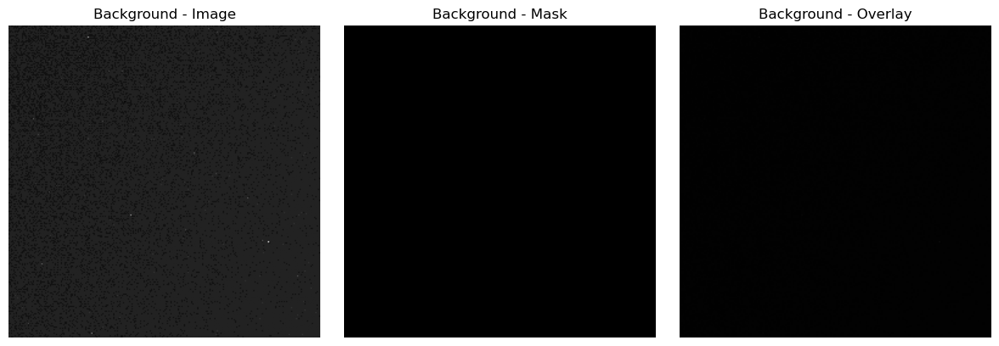

Saved 14184 total patches.

Showing 5 patches from image: 017_43-17-ROOT1-2023-08-08_pvd_OD001_Col0_03-Fish Eye Corrected


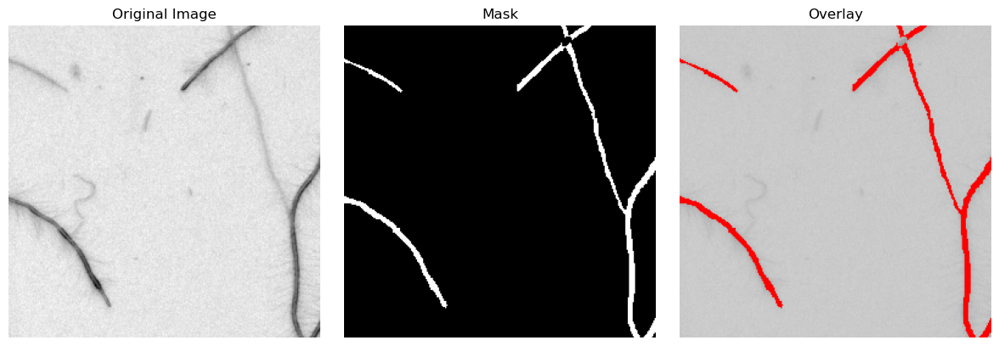

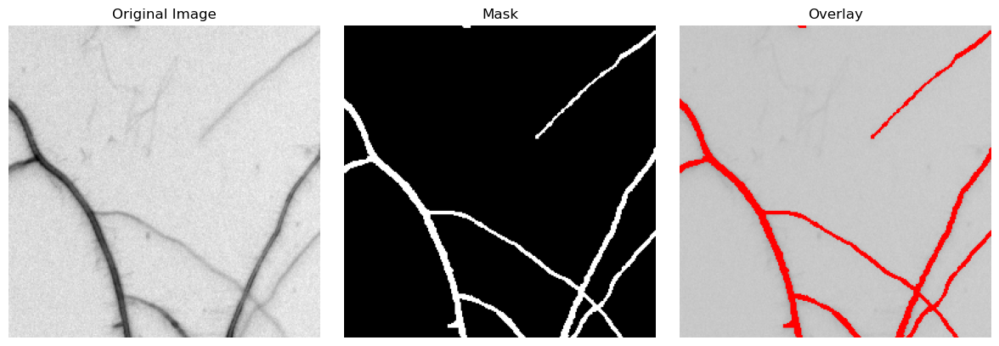

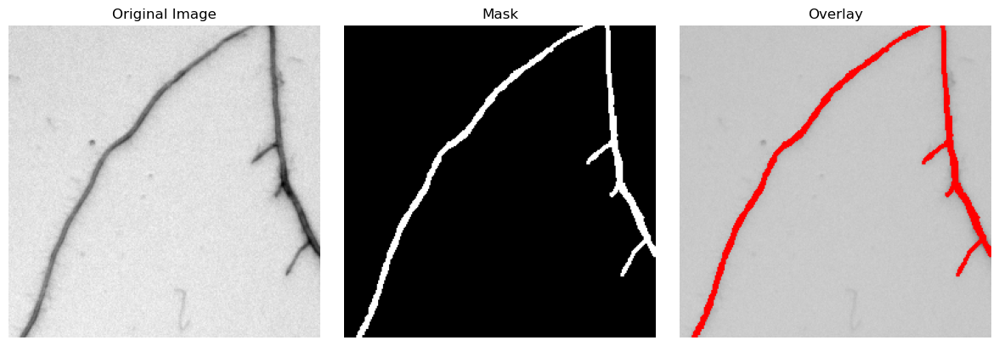

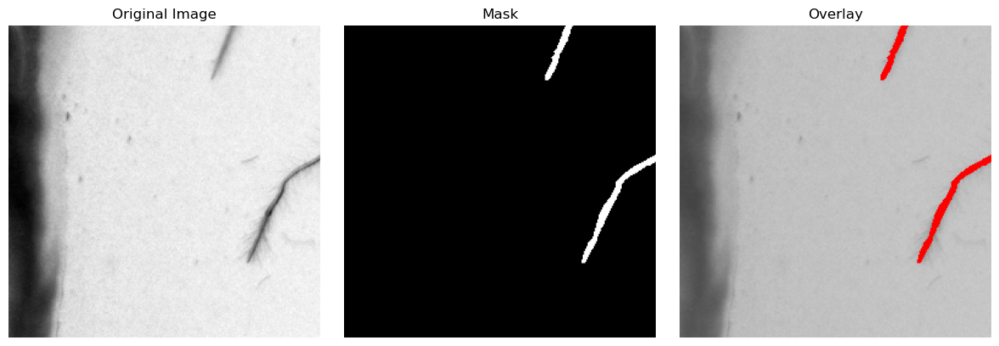

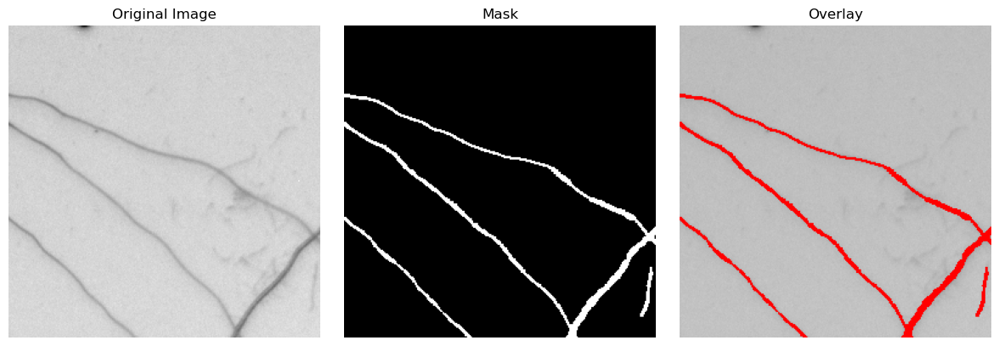

In [69]:
# === VISUALIZER ===
def visualize_random_patches(image_dir, mask_dir, num_patches=5, min_mask_pixels=10):
    image_filenames = [f for f in os.listdir(image_dir) if f.endswith('.png') and not f.startswith("._")]
    random.shuffle(image_filenames)

    patch_groups = {}
    for fname in image_filenames:
        parts = fname.split("_")
        base = "_".join(parts[:-2]) if parts[-1].isdigit() else "_".join(parts[:-1])
        patch_groups.setdefault(base, []).append(fname)

    for base_name, patch_list in patch_groups.items():
        selected = []
        for fname in patch_list:
            img_path = os.path.join(image_dir, fname)
            mask_path = os.path.join(mask_dir, fname.replace(".png", ".tif"))

            image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            if image is None or mask is None:
                continue
            if np.sum(mask) >= min_mask_pixels:
                selected.append((fname, image, mask))
            if len(selected) >= num_patches:
                break

        if selected:
            print(f"\nShowing {len(selected)} patches from image: {base_name}")
            for fname, image, mask in selected:
                mask_display = mask.astype(np.float32) / 255.0 if mask.max() > 1 else mask.astype(np.float32)
                overlay = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
                overlay[mask > 0] = [255, 0, 0]

                fig, axs = plt.subplots(1, 3, figsize=(12, 4))
                axs[0].imshow(image, cmap='gray')
                axs[0].set_title("Original Image")
                axs[1].imshow(mask_display, cmap='gray')
                axs[1].set_title("Mask")
                axs[2].imshow(overlay)
                axs[2].set_title("Overlay")
                for ax in axs:
                    ax.axis('off')
                plt.tight_layout()
                plt.show()
            break
    
patch_and_save_filtered_with_preview(
    image_dir="dataset_23/train_images/train",
    mask_dir="dataset_23/train_masks/train",
    out_img_dir="balanced_dataset_23/train_images/train",
    out_mask_dir="balanced_dataset_23/train_masks/train",
    patch_size=256,
    stride=128,
    visualize=True,
)

## 2024 dataset

In [70]:
def objective(trial):
    min_ratio = trial.suggest_float("min_ratio", 0.001, 0.02, log=True) # log scaled
    min_area = trial.suggest_int("min_area", 20, 150) # integer

    return evaluate_filter_config(
        patch_mask_dir="patched_dataset_24/train_masks/train",
        min_ratio=min_ratio,
        min_area=min_area,
    )


# Run study
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)

# Results
best_params = study.best_params
print("Best parameters:", best_params)
print("Best score:", study.best_value)

study.trials_dataframe()

[I 2025-08-14 17:58:32,045] A new study created in memory with name: no-name-4f0c37b0-1308-4ec6-9df5-b46af754aa8d
[I 2025-08-14 17:58:33,289] Trial 0 finished with value: 0.0 and parameters: {'min_ratio': 0.013755074807238284, 'min_area': 42}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:58:33,415] Trial 1 finished with value: 0.0 and parameters: {'min_ratio': 0.008687610758418503, 'min_area': 69}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:58:33,544] Trial 2 finished with value: 0.0 and parameters: {'min_ratio': 0.006627664554364788, 'min_area': 50}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:58:33,665] Trial 3 finished with value: 0.0 and parameters: {'min_ratio': 0.003667564166850772, 'min_area': 115}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:58:33,790] Trial 4 finished with value: 0.0 and parameters: {'min_ratio': 0.0019634273979349756, 'min_area': 51}. Best is trial 0 with value: 0.0.
[I 2025-08-14 17:58:33,914] Trial 5 finished with value: 0.0 and para

Best parameters: {'min_ratio': 0.013755074807238284, 'min_area': 42}
Best score: 0.0


,number,value,datetime_start,datetime_complete,duration,params_min_area,params_min_ratio,state
0,0,0.0,2025-08-14 17:58:32.046196,2025-08-14 17:58:33.289796,0 days 00:00:01.243600,42,0.013755,COMPLETE
1,1,0.0,2025-08-14 17:58:33.289796,2025-08-14 17:58:33.415749,0 days 00:00:00.125953,69,0.008688,COMPLETE
2,2,0.0,2025-08-14 17:58:33.415749,2025-08-14 17:58:33.543885,0 days 00:00:00.128136,50,0.006628,COMPLETE
3,3,0.0,2025-08-14 17:58:33.544887,2025-08-14 17:58:33.665125,0 days 00:00:00.120238,115,0.003668,COMPLETE
4,4,0.0,2025-08-14 17:58:33.665125,2025-08-14 17:58:33.790475,0 days 00:00:00.125350,51,0.001963,COMPLETE
5,5,0.0,2025-08-14 17:58:33.791598,2025-08-14 17:58:33.914516,0 days 00:00:00.122918,94,0.002199,COMPLETE
6,6,0.0,2025-08-14 17:58:33.915593,2025-08-14 17:58:34.038466,0 days 00:00:00.122873,48,0.019564,COMPLETE
7,7,0.0,2025-08-14 17:58:34.038466,2025-08-14 17:58:34.162544,0 days 00:00:00.124078,143,0.001776,COMPLETE
8,8,0.0,2025-08-14 17:58:34.162544,2025-08-14 17:58:34.282945,0 days 00:00:00.120401,42,0.003168,COMPLETE
9,9,0.0,2025-08-14 17:58:34.282945,2025-08-14 17:58:34.399713,0 days 00:00:00.116768,107,0.001567,COMPLETE


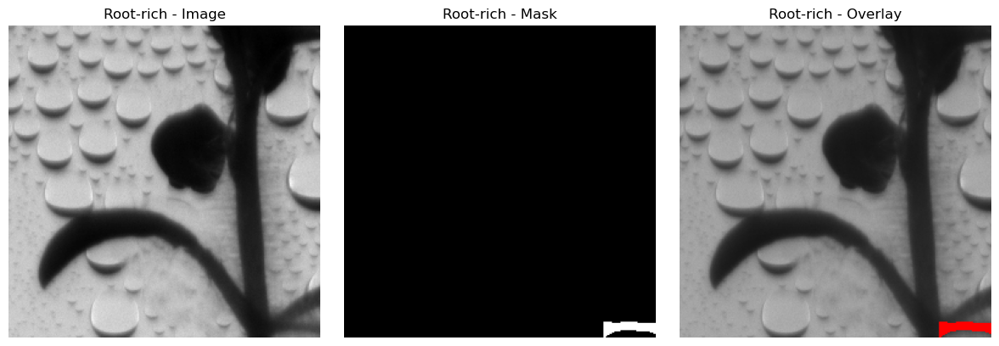

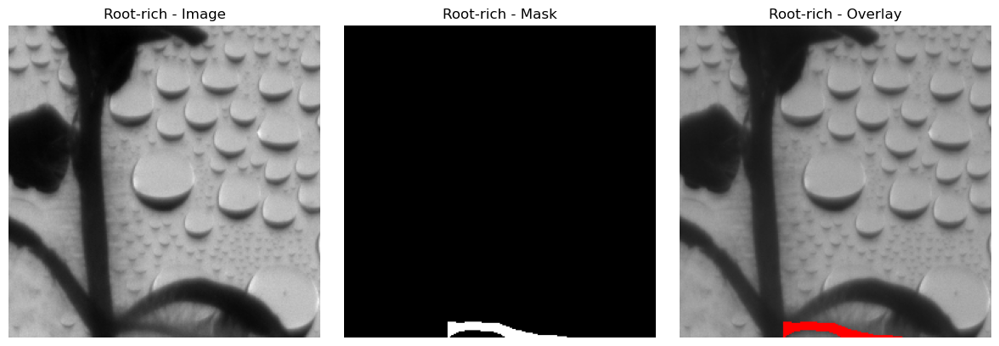

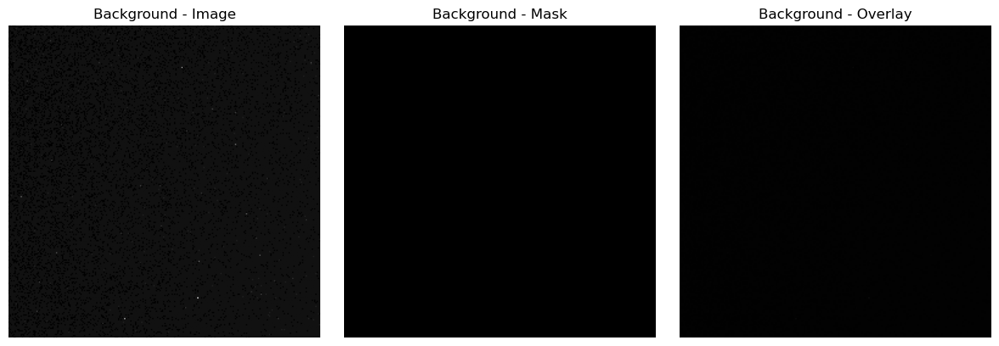

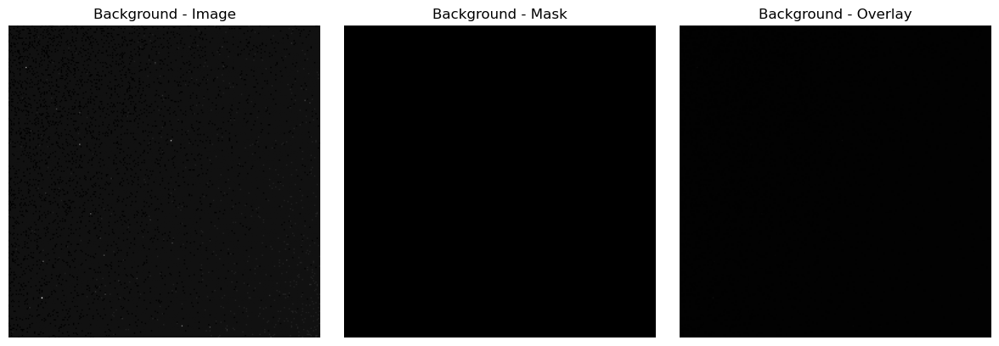

Saved 24466 total patches.

Showing 5 patches from image: train_Elavendan_232345_im3


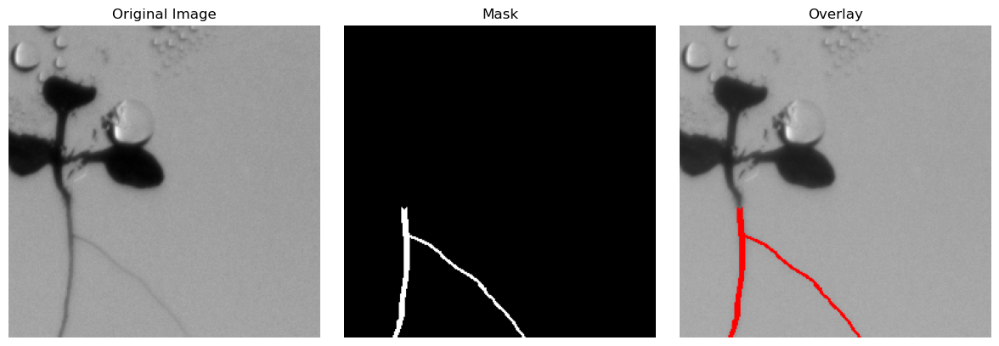

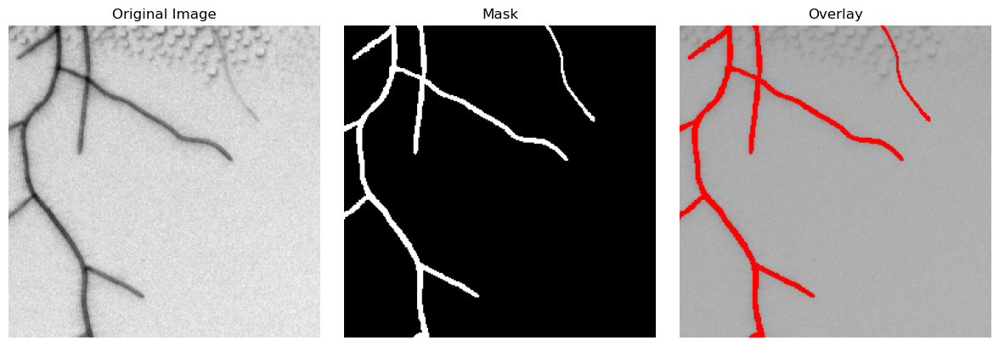

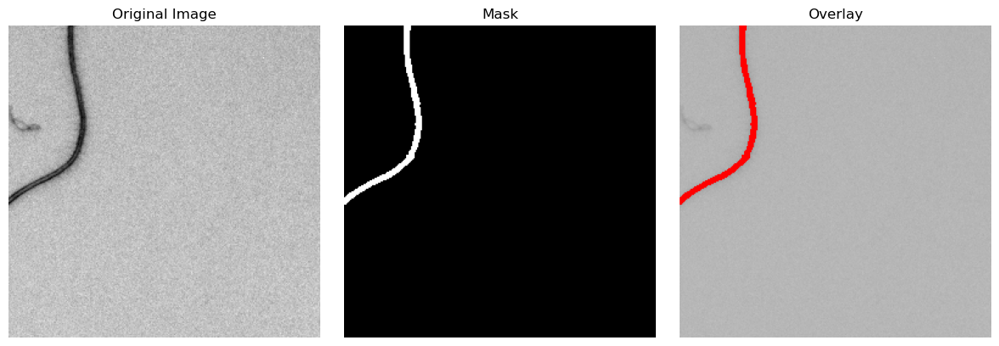

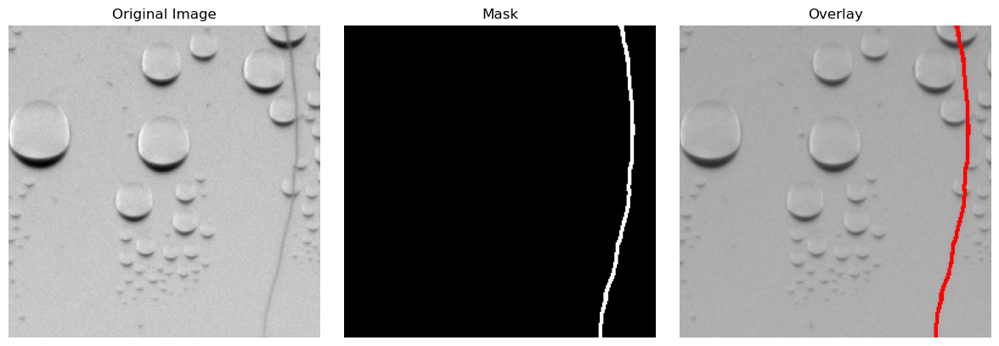

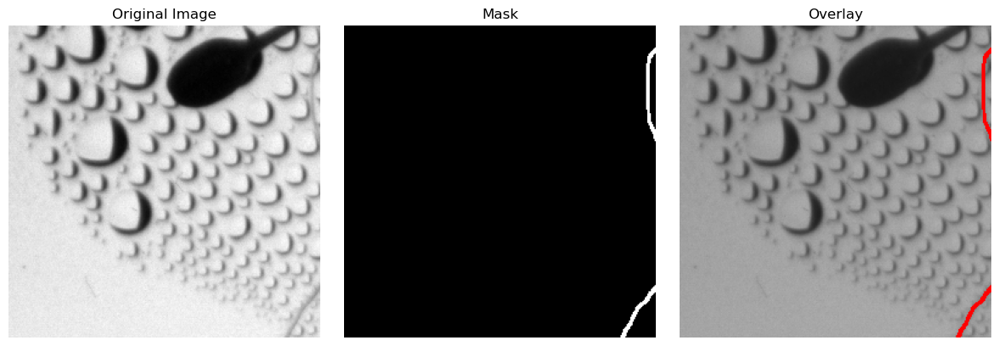

In [71]:
patch_and_save_filtered_with_preview(
    image_dir="dataset_24/train_images/train",
    mask_dir="dataset_24/train_masks/train",
    out_img_dir="balanced_dataset_24/train_images/train",
    out_mask_dir="balanced_dataset_24/train_masks/train",
    patch_size=256,
    stride=128,
    visualize=True,
)

In [72]:
# For 2024
copy_val_folders("patched_dataset_24", "balanced_dataset_24")

Copied validation images from patched_dataset_24\val_images\val to balanced_dataset_24\val_images\val
Copied validation masks from patched_dataset_24\val_masks\val to balanced_dataset_24\val_masks\val


## Combining datasets: balanced_dataset

In [73]:
merge_datasets(
    src1="balanced_dataset_23",
    src2="balanced_dataset_24",
    dest="balanced_dataset",
    include_val_from="balanced_dataset_24"
)

Merged training data from balanced_dataset_23 and balanced_dataset_24 into balanced_dataset
Included validation set from balanced_dataset_24


# This notebook has been ran on the full 2023 and 2024 datasets separately, and the zipped final datasets has been uploaded to Sharepoint, and can be found here:

[dataset](https://edubuas-my.sharepoint.com/:u:/g/personal/236578_buas_nl/ES9XPnWUkLhAvoZ5ICyF_2cBAXc1j22ZJOpeBvR3U0DnvQ?e=zctcYy)

[simple_fltered_dataset](https://edubuas-my.sharepoint.com/:u:/g/personal/236578_buas_nl/ESF4U4A_dmtIkRR7uwQTfbIBfIZXeMd5c82MI1ZOsQPJXw?e=l2T9uO)

[tuned_dataset](https://edubuas-my.sharepoint.com/:u:/g/personal/236578_buas_nl/EQi1tOF1UFJLvYRNWIoO35EBlkZwkxD5lVnAm6gSgBiY4A?e=YJMrrG)

[augmented dataset](https://edubuas-my.sharepoint.com/:u:/g/personal/236578_buas_nl/EQCH1jnHIg9IvcbNNtIdFmsB0ne4dYfegldjWvrKEhalSQ?e=nK8pSr)

[balanced_dataset](https://edubuas-my.sharepoint.com/:u:/g/personal/236578_buas_nl/EYFwPsl00YFFlHf-h3ddQQ4BBl7q__Tv-qhgPm1BQ4zvig?e=VlfF9M)